# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [7]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [8]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [42]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(),y.float()),1)
    #### END CODE HERE ####
    return combined.float()

In [43]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [36]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [37]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [38]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [39]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [40]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.271864293575287, discriminator loss: 0.24415249661356211


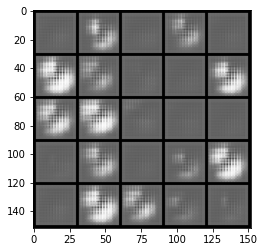

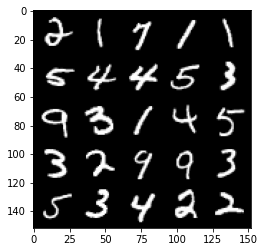

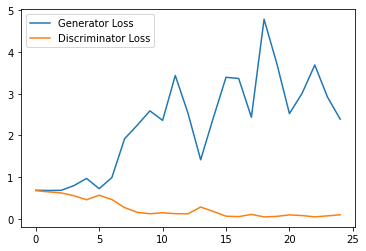

Step 1000: Generator loss: 4.293096762657165, discriminator loss: 0.046208168039098385


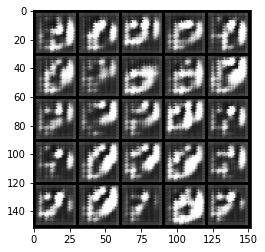

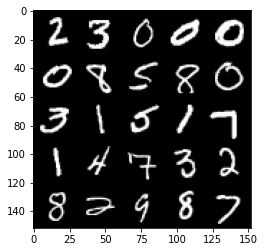

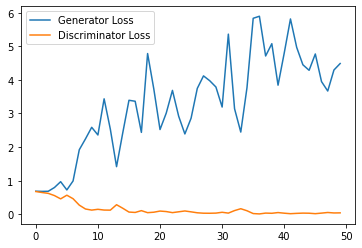

Step 1500: Generator loss: 4.330188226222992, discriminator loss: 0.05447422239370644


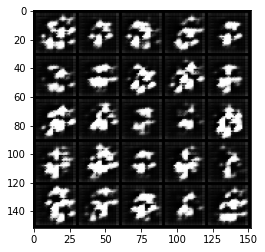

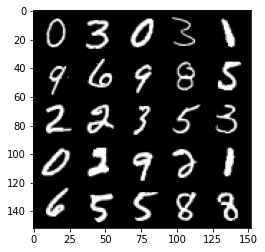

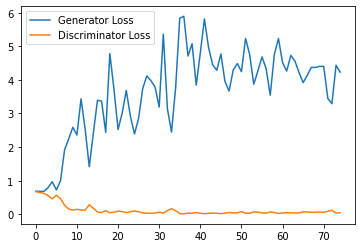

Step 2000: Generator loss: 3.219846881866455, discriminator loss: 0.14263429263979197


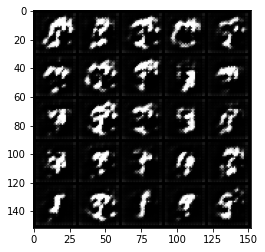

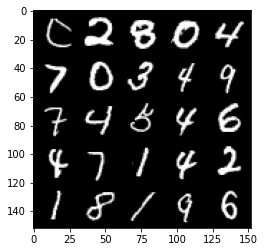

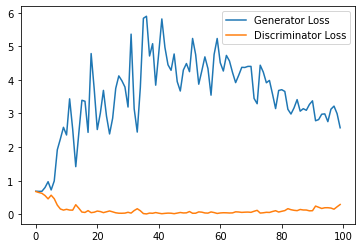

Step 2500: Generator loss: 2.3763120000362394, discriminator loss: 0.2758395633548498


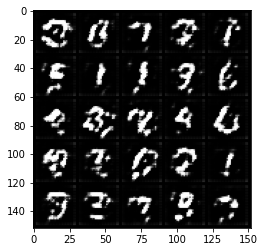

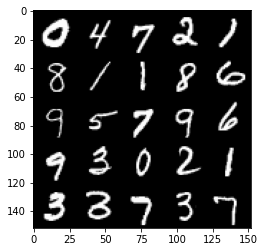

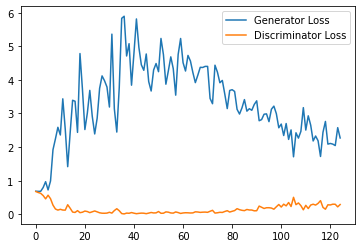

Step 3000: Generator loss: 2.3137544598579405, discriminator loss: 0.33569599862396715


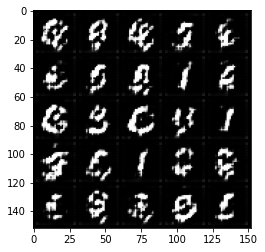

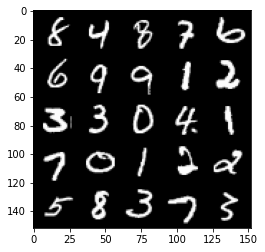

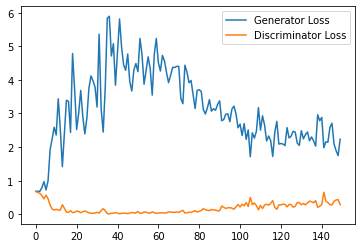

Step 3500: Generator loss: 1.9911929643154145, discriminator loss: 0.31601548272371294


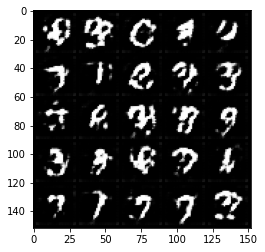

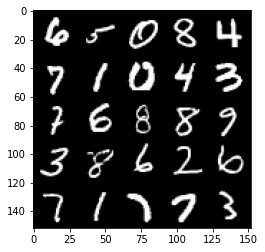

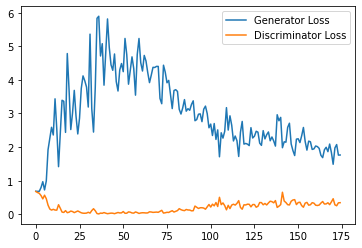

Step 4000: Generator loss: 2.069708509683609, discriminator loss: 0.32951080092787743


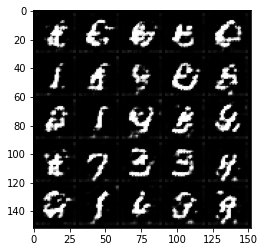

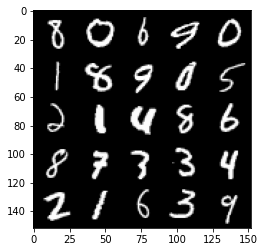

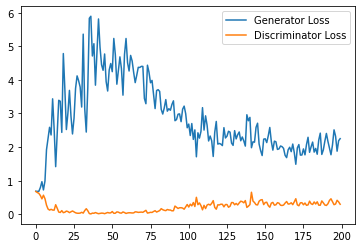

Step 4500: Generator loss: 2.1236755471229554, discriminator loss: 0.34742029415071013


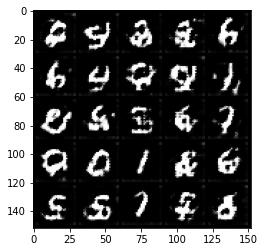

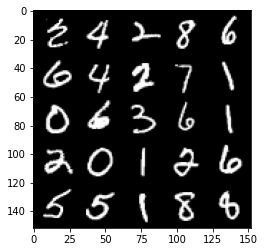

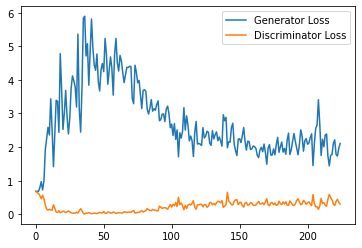

Step 5000: Generator loss: 1.9877541356086732, discriminator loss: 0.29973595184087753


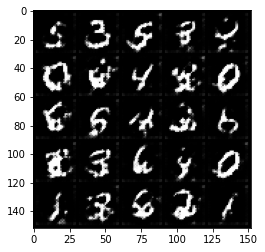

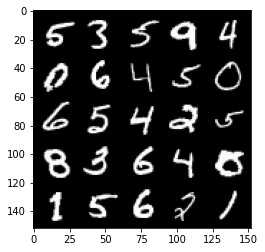

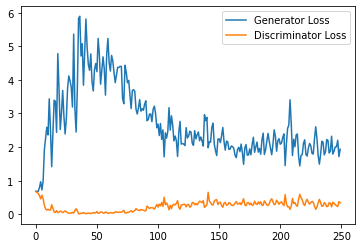

Step 5500: Generator loss: 2.001719457387924, discriminator loss: 0.34721088150143625


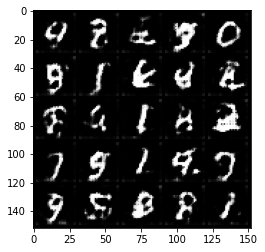

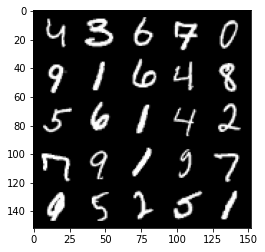

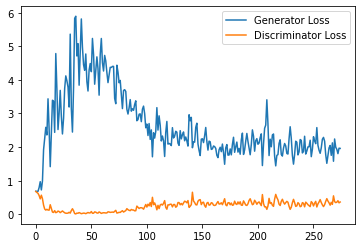

Step 6000: Generator loss: 1.7856525571346282, discriminator loss: 0.38266732093691824


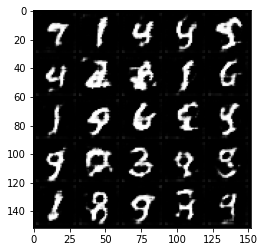

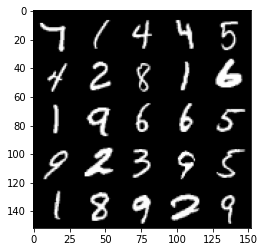

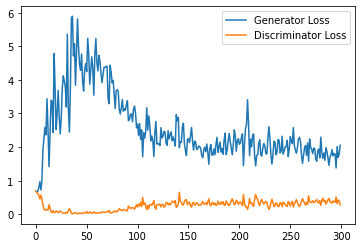

Step 6500: Generator loss: 1.647617648124695, discriminator loss: 0.4130009350776672


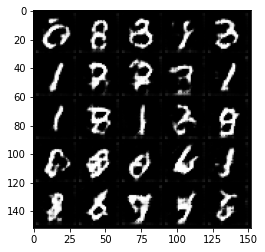

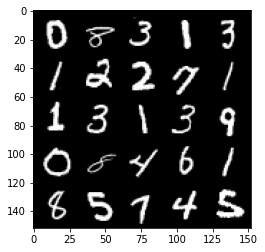

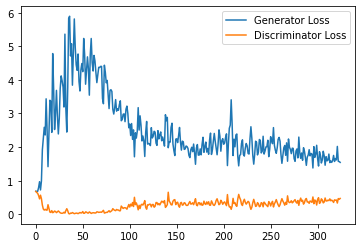

Step 7000: Generator loss: 1.5343479973077774, discriminator loss: 0.4453830675184727


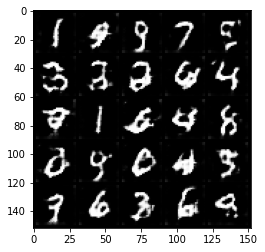

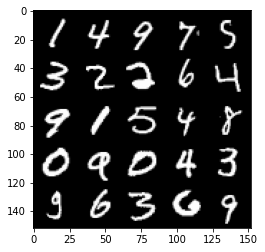

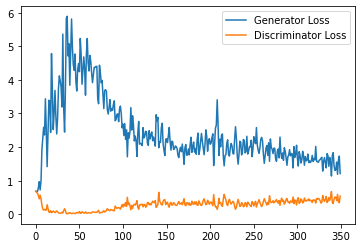

Step 7500: Generator loss: 1.4380298191308976, discriminator loss: 0.47685015058517455


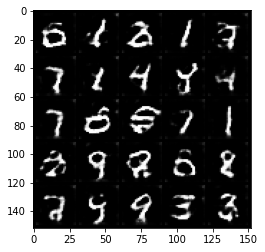

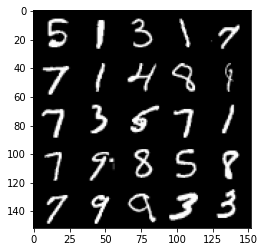

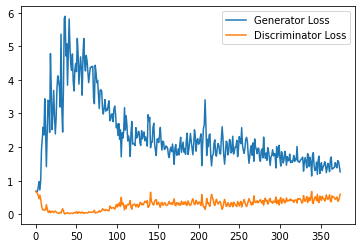

Step 8000: Generator loss: 1.3564082551002503, discriminator loss: 0.49512007653713225


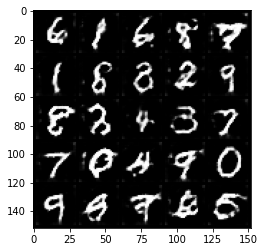

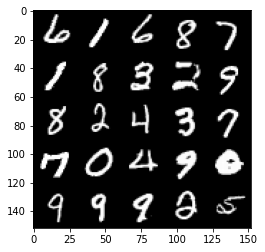

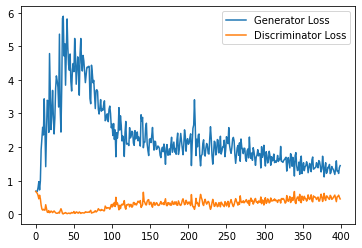

Step 8500: Generator loss: 1.324869626879692, discriminator loss: 0.5180100803375244


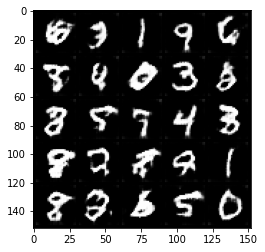

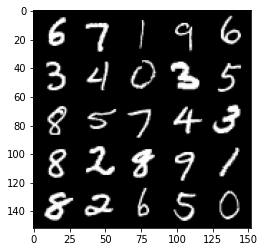

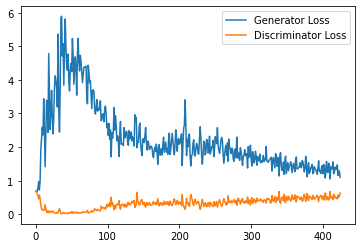

Step 9000: Generator loss: 1.3544781554937362, discriminator loss: 0.5282155453562737


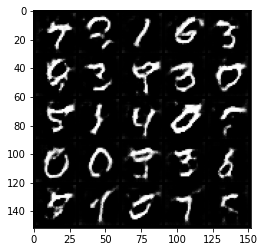

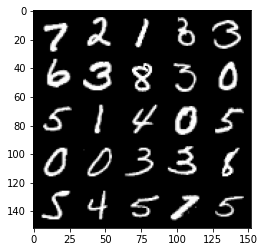

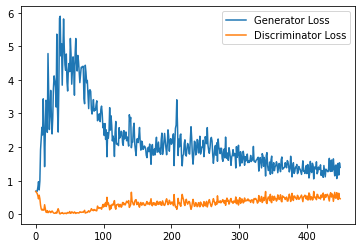

Step 9500: Generator loss: 1.3360483700037002, discriminator loss: 0.5159737287759781


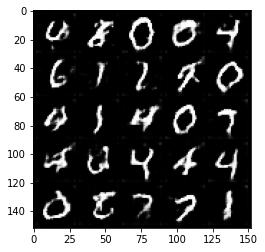

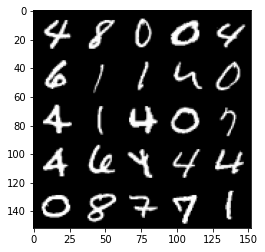

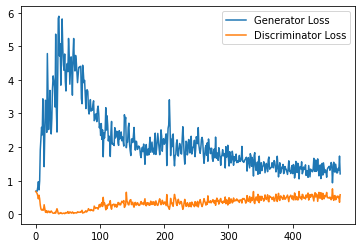

Step 10000: Generator loss: 1.238958115696907, discriminator loss: 0.5452170513868332


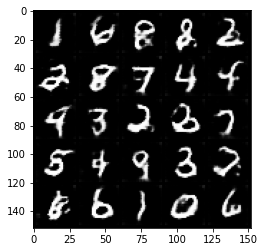

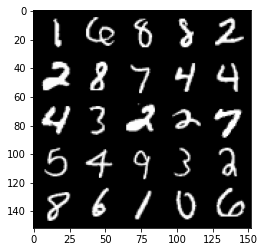

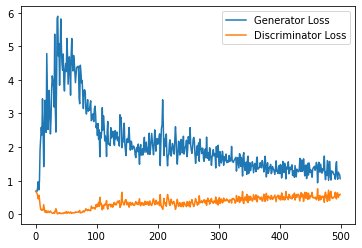

Step 10500: Generator loss: 1.28314693069458, discriminator loss: 0.5417600083947182


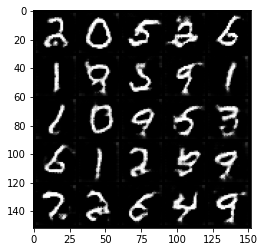

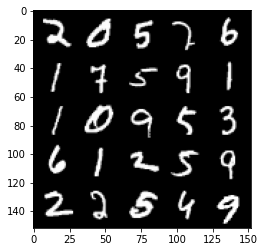

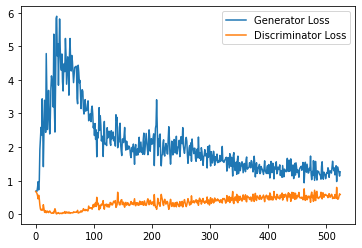

Step 11000: Generator loss: 1.2375513273477554, discriminator loss: 0.5347211517691612


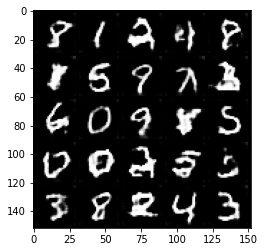

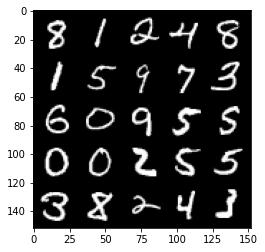

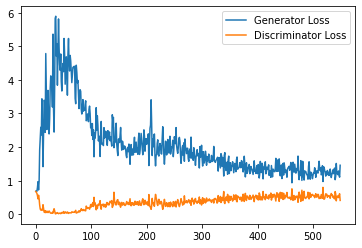

Step 11500: Generator loss: 1.2058987272977828, discriminator loss: 0.5373670353889465


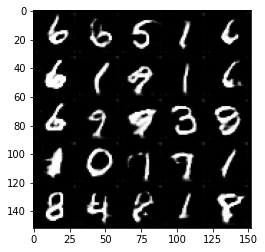

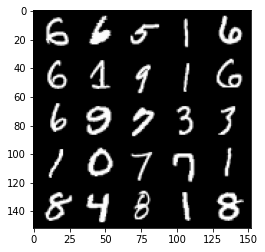

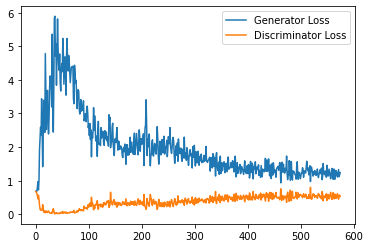

Step 12000: Generator loss: 1.2121122012138366, discriminator loss: 0.5390857704281807


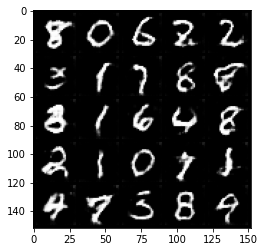

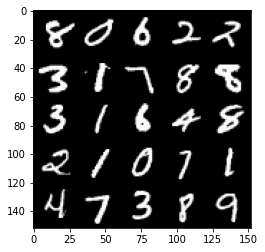

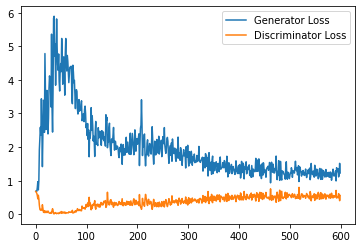

Step 12500: Generator loss: 1.2062948007583618, discriminator loss: 0.5405414599180222


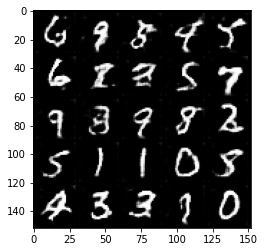

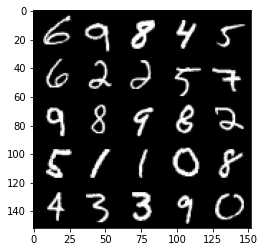

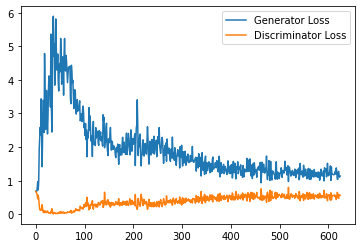

Step 13000: Generator loss: 1.1805921708345413, discriminator loss: 0.5466980537176133


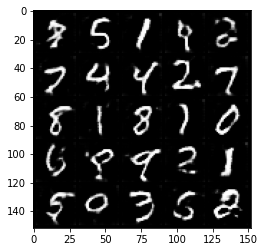

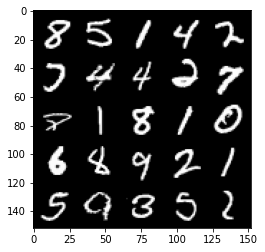

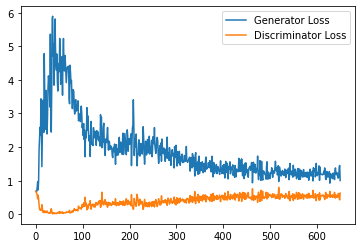

Step 13500: Generator loss: 1.215014673113823, discriminator loss: 0.552417454957962


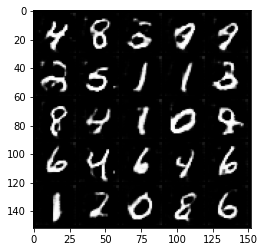

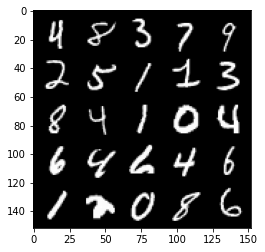

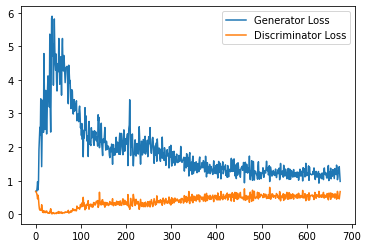

Step 14000: Generator loss: 1.120469438791275, discriminator loss: 0.5533322163820267


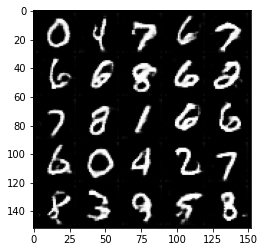

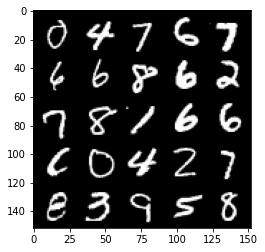

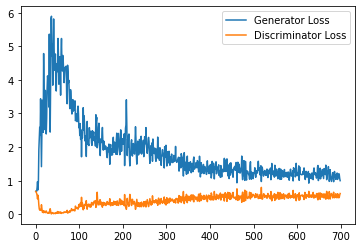

Step 14500: Generator loss: 1.1767038596868515, discriminator loss: 0.5489516736268997


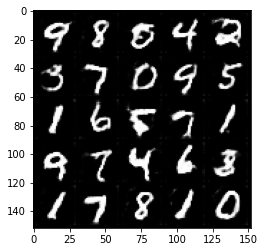

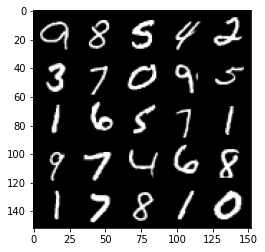

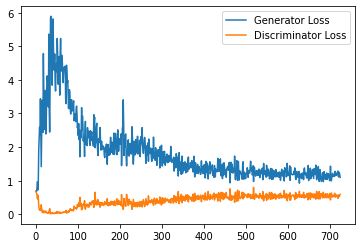

Step 15000: Generator loss: 1.194394563317299, discriminator loss: 0.5472366819977761


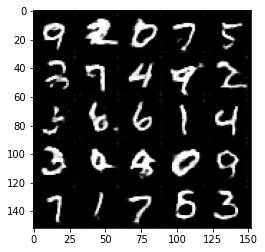

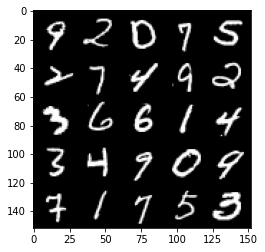

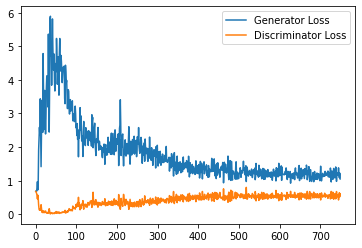

Step 15500: Generator loss: 1.1555546798706056, discriminator loss: 0.5426462478637696


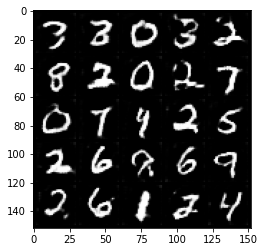

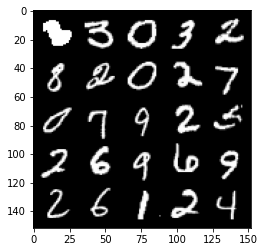

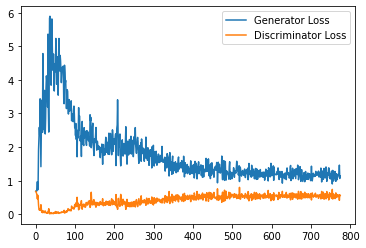

Step 16000: Generator loss: 1.1482371525764465, discriminator loss: 0.5479248955845832


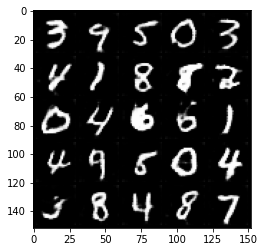

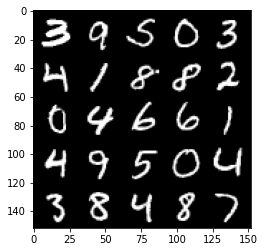

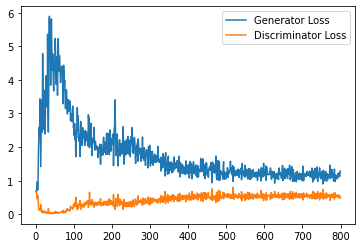

Step 16500: Generator loss: 1.1257394660711288, discriminator loss: 0.548529213309288


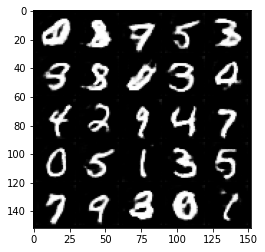

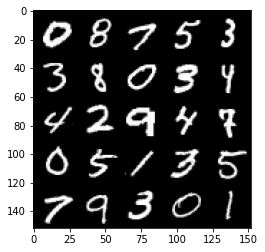

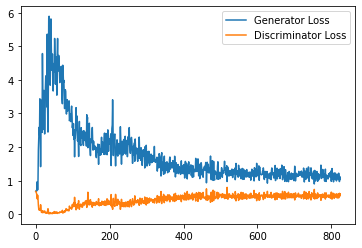

Step 17000: Generator loss: 1.1591327579021453, discriminator loss: 0.5391488738059997


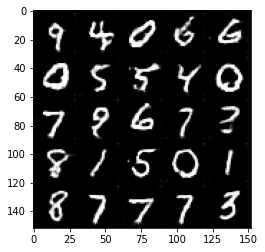

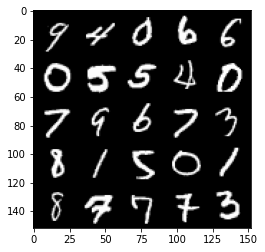

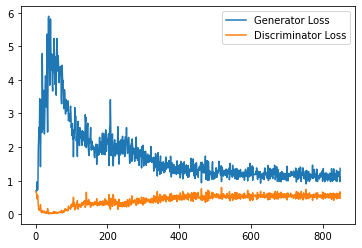

Step 17500: Generator loss: 1.146511908888817, discriminator loss: 0.5428924089074135


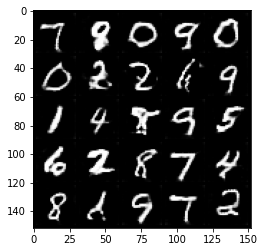

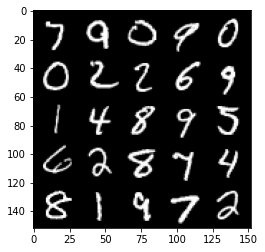

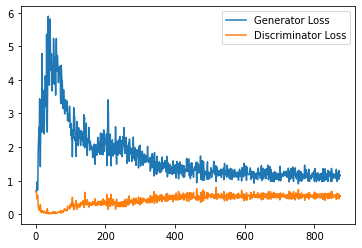

Step 18000: Generator loss: 1.1675187611579896, discriminator loss: 0.5403839713335037


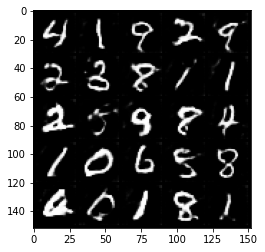

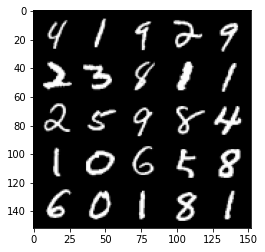

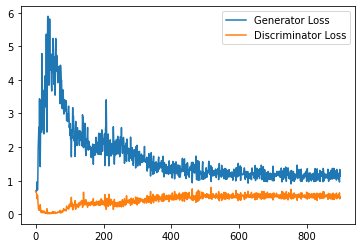

Step 18500: Generator loss: 1.1075551615953445, discriminator loss: 0.5559790001511574


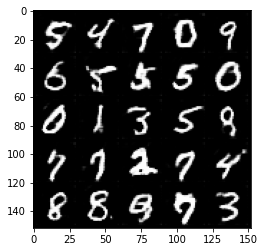

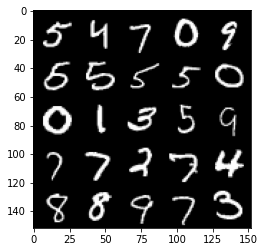

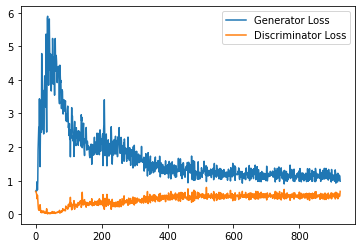

Step 19000: Generator loss: 1.1544872505664825, discriminator loss: 0.5441644098162651


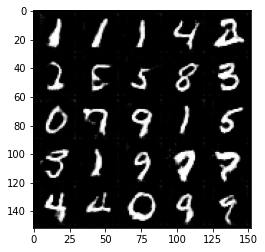

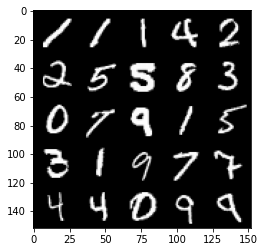

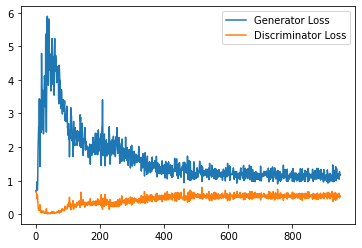

Step 19500: Generator loss: 1.171702503323555, discriminator loss: 0.5486511622071266


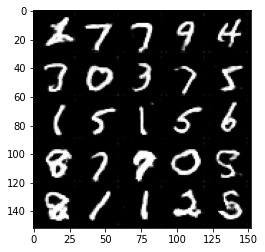

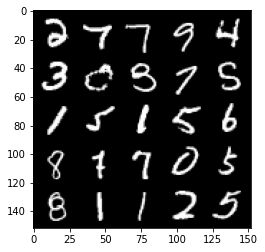

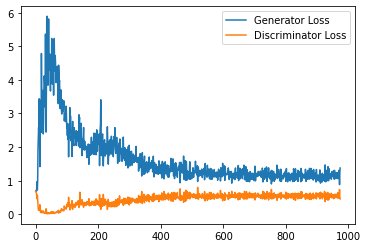

Step 20000: Generator loss: 1.1500054768323897, discriminator loss: 0.5479005282521248


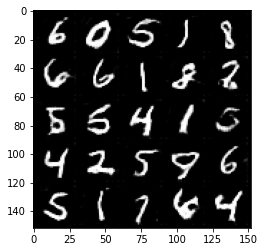

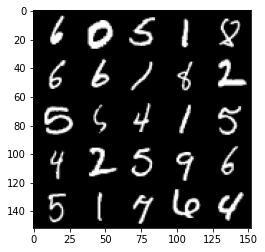

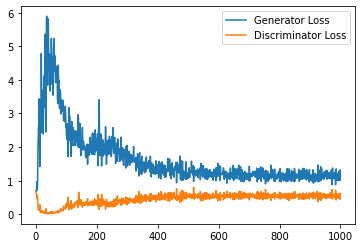

Step 20500: Generator loss: 1.1561474044322968, discriminator loss: 0.5499878678321838


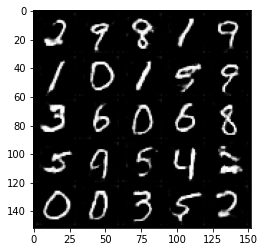

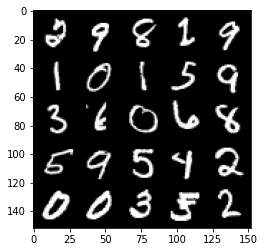

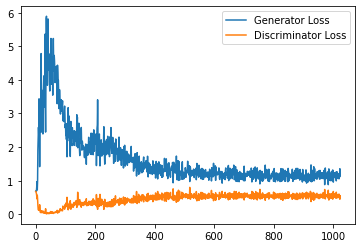

Step 21000: Generator loss: 1.1473427489995955, discriminator loss: 0.5605005034804345


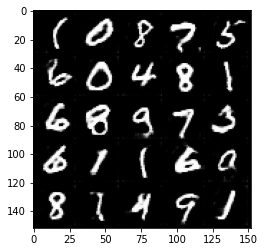

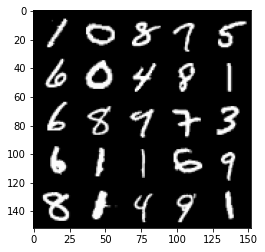

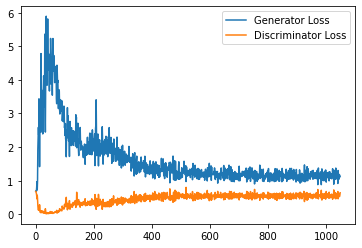

Step 21500: Generator loss: 1.142288871884346, discriminator loss: 0.5498639214634895


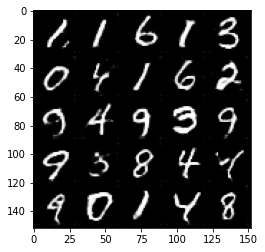

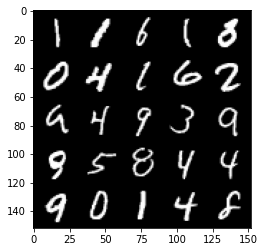

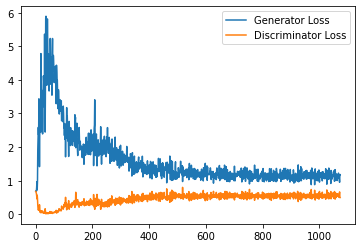

Step 22000: Generator loss: 1.113914267897606, discriminator loss: 0.5576792030334473


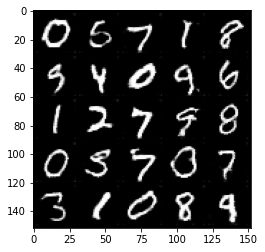

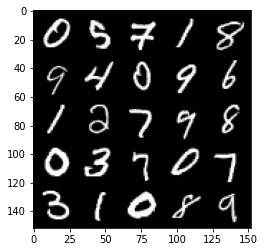

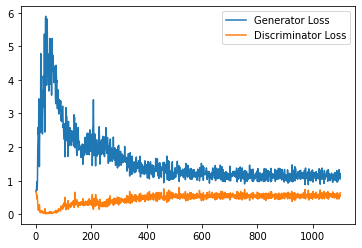

Step 22500: Generator loss: 1.1369861520528792, discriminator loss: 0.5496005961894989


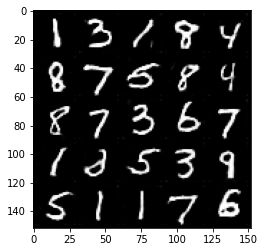

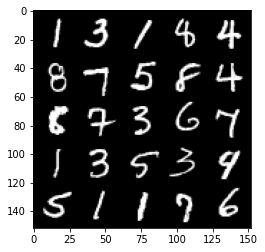

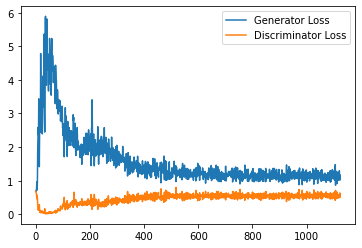

Step 23000: Generator loss: 1.121071194410324, discriminator loss: 0.5516059575080872


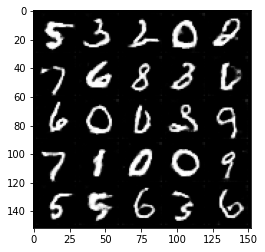

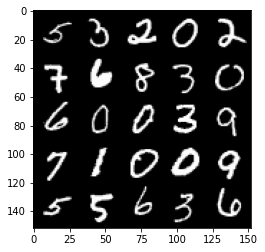

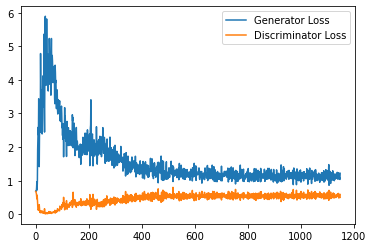

Step 23500: Generator loss: 1.152316781759262, discriminator loss: 0.5472806198596954


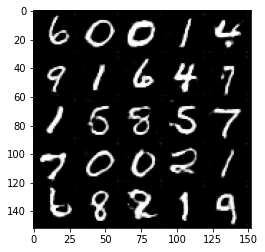

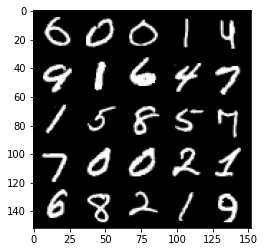

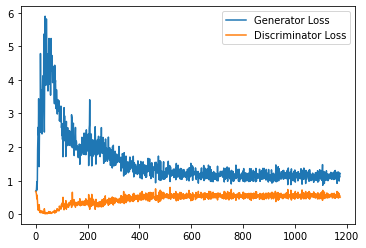

Step 24000: Generator loss: 1.1540994725227356, discriminator loss: 0.5507556900382042


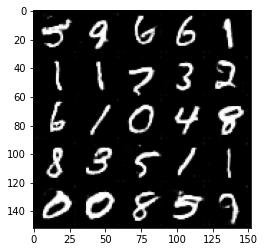

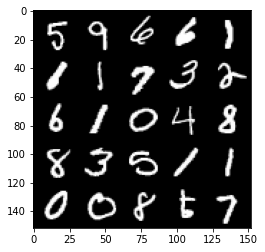

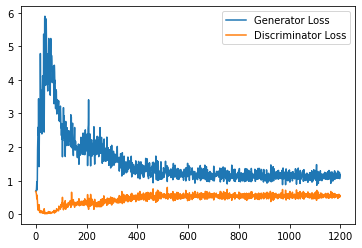

Step 24500: Generator loss: 1.1270504114627837, discriminator loss: 0.5505687626600265


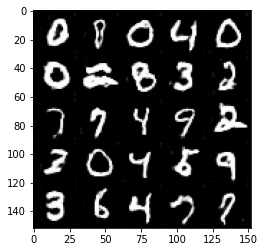

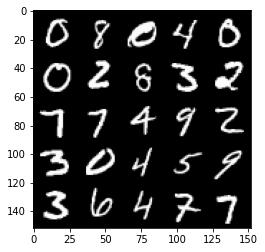

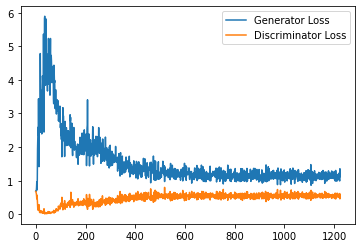

Step 25000: Generator loss: 1.123445594906807, discriminator loss: 0.5515985607504844


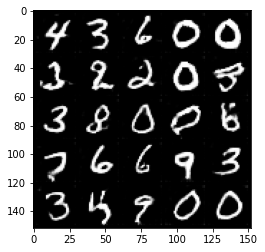

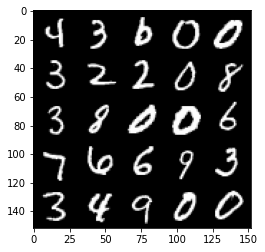

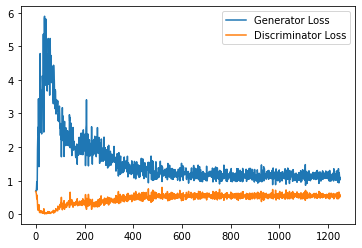

Step 25500: Generator loss: 1.0838433616161347, discriminator loss: 0.5553513913154602


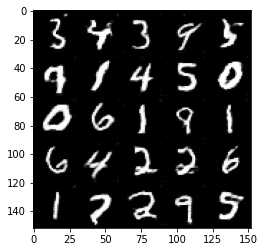

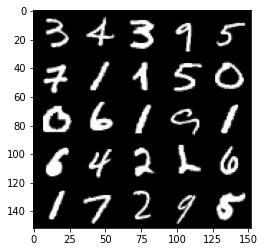

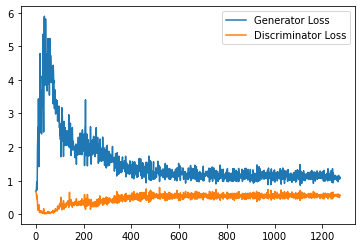

Step 26000: Generator loss: 1.130177433371544, discriminator loss: 0.5528137466907501


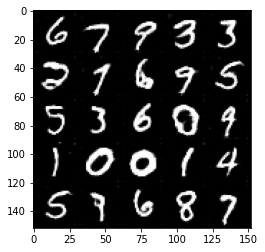

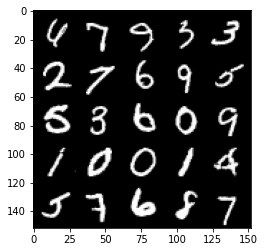

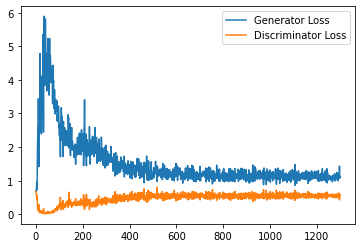

Step 26500: Generator loss: 1.1157659935951232, discriminator loss: 0.5474813824295998


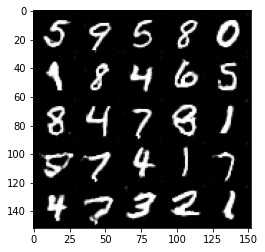

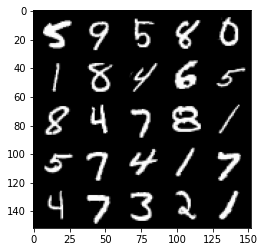

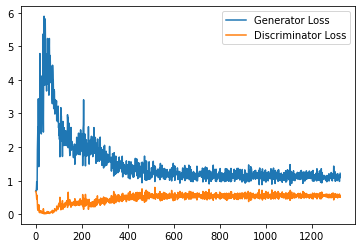

Step 27000: Generator loss: 1.1271672304868698, discriminator loss: 0.5524314107894898


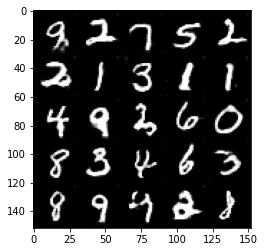

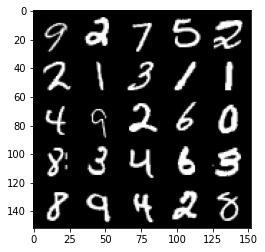

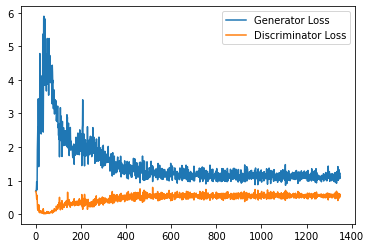

Step 27500: Generator loss: 1.1396080870628358, discriminator loss: 0.5535782735943794


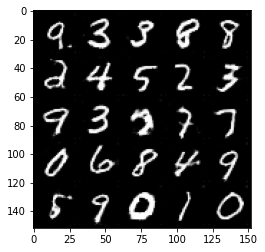

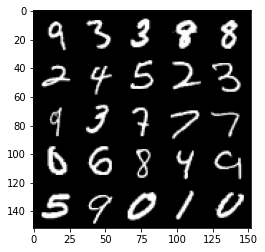

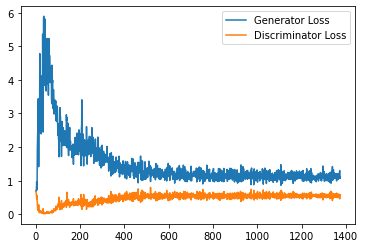

Step 28000: Generator loss: 1.1035215808153152, discriminator loss: 0.5548955707550048


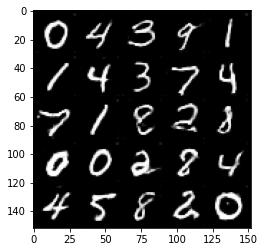

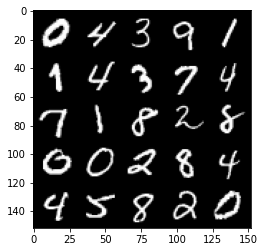

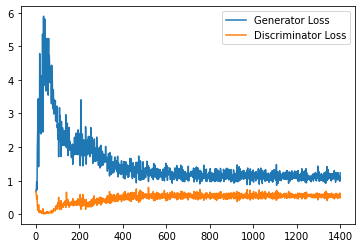

Step 28500: Generator loss: 1.0838884902000427, discriminator loss: 0.5565085632205009


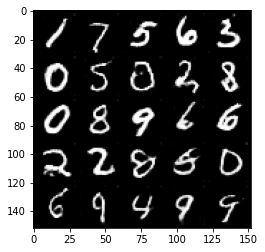

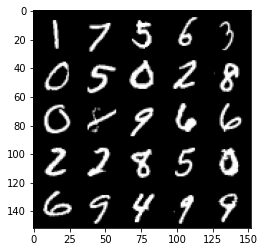

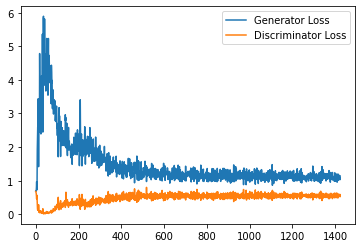

Step 29000: Generator loss: 1.1081247121095656, discriminator loss: 0.5603090081214904


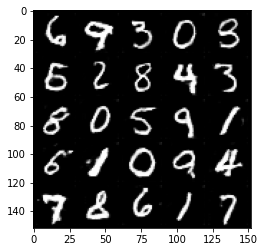

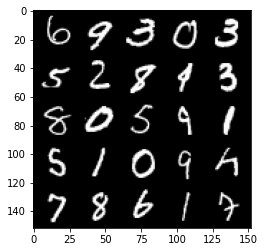

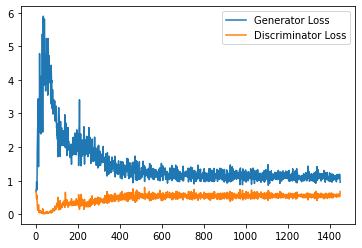

Step 29500: Generator loss: 1.114748621582985, discriminator loss: 0.5533339426517486


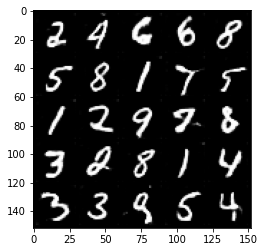

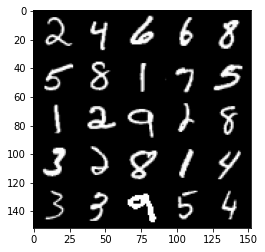

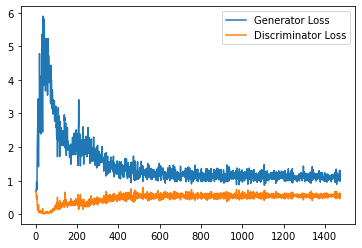

Step 30000: Generator loss: 1.0975423755645752, discriminator loss: 0.5616555155515671


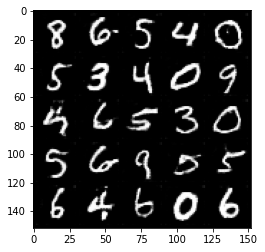

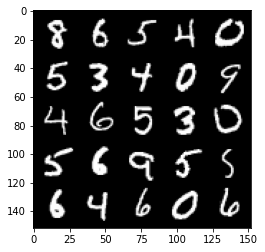

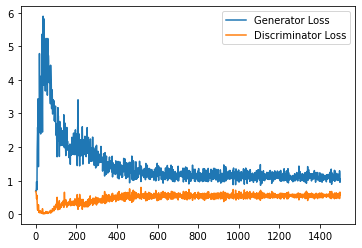

Step 30500: Generator loss: 1.1168285557031632, discriminator loss: 0.56187668633461


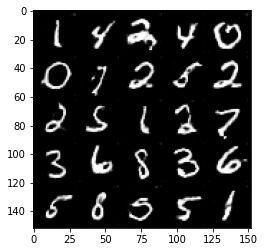

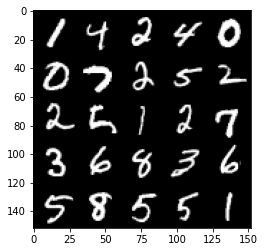

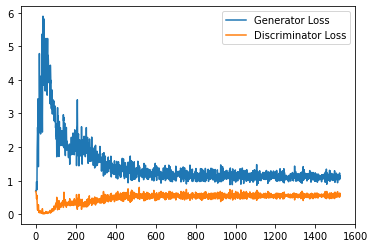

Step 31000: Generator loss: 1.1120686753988267, discriminator loss: 0.5604254266619683


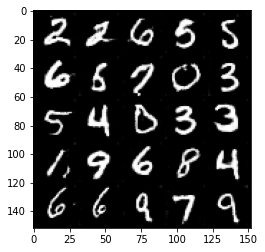

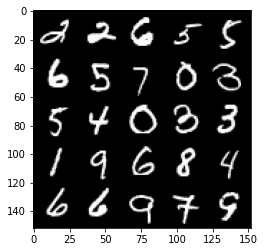

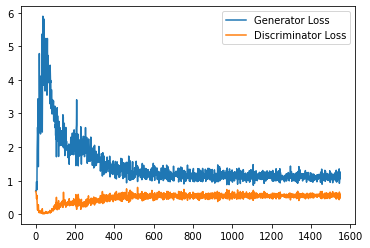

Step 31500: Generator loss: 1.100008116722107, discriminator loss: 0.5620160401463509


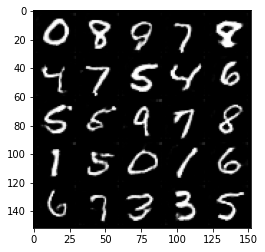

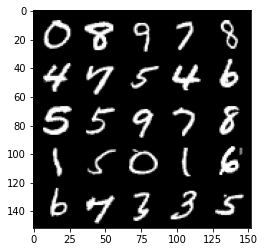

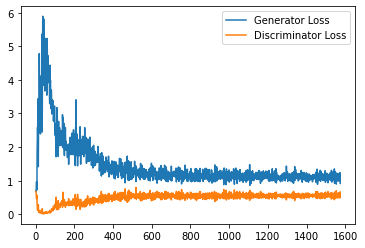

Step 32000: Generator loss: 1.1055202380418778, discriminator loss: 0.5517945222258568


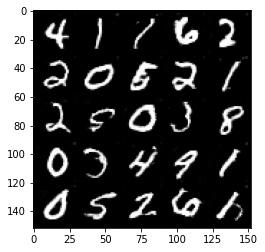

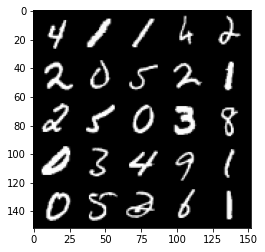

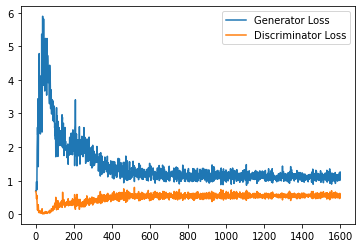

Step 32500: Generator loss: 1.0950024435520171, discriminator loss: 0.5656230794787407


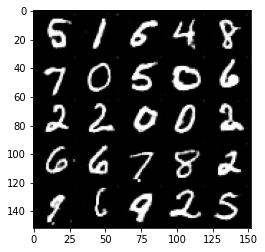

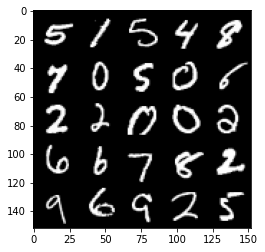

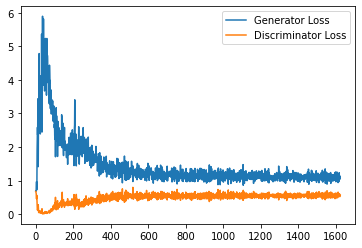

Step 33000: Generator loss: 1.0920048388242722, discriminator loss: 0.5650871372222901


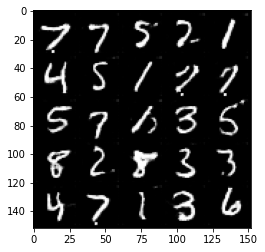

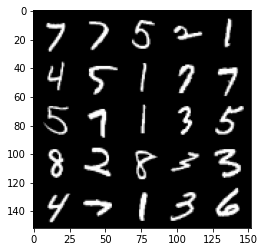

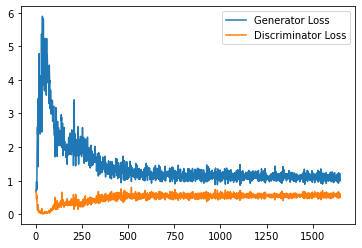

Step 33500: Generator loss: 1.096733332157135, discriminator loss: 0.5547193655967713


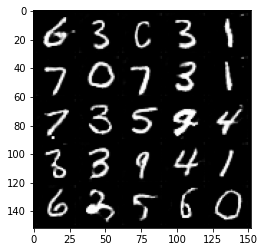

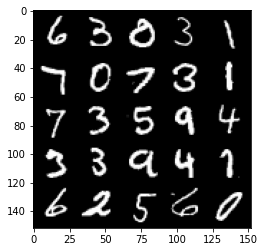

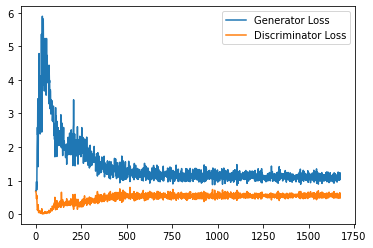

Step 34000: Generator loss: 1.104178390622139, discriminator loss: 0.5687220544219017


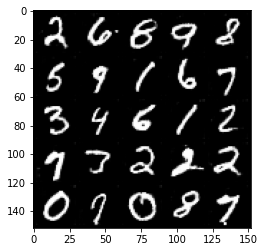

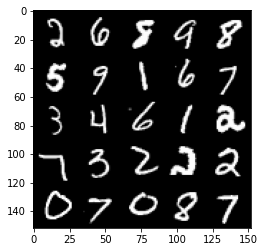

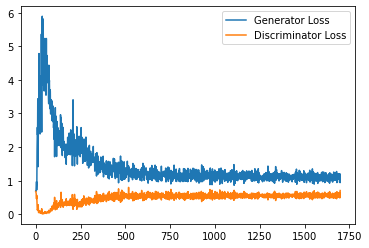

Step 34500: Generator loss: 1.0989520291090011, discriminator loss: 0.5666035106778144


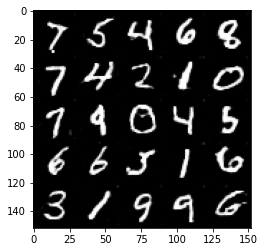

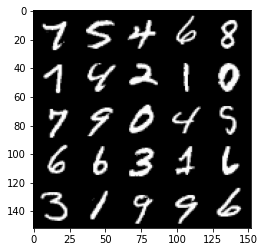

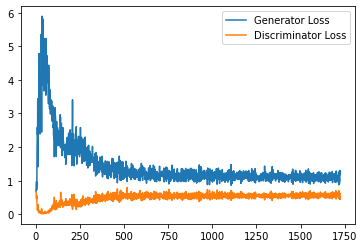

Step 35000: Generator loss: 1.082558786392212, discriminator loss: 0.5679628010392189


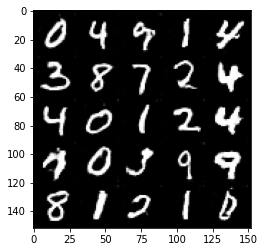

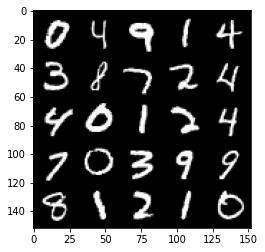

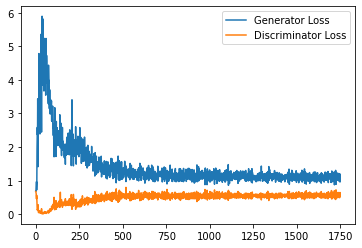

Step 35500: Generator loss: 1.105344100356102, discriminator loss: 0.5583320924639702


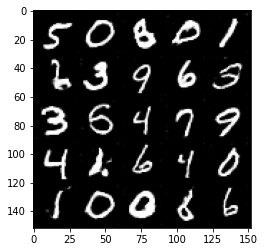

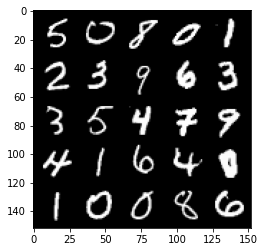

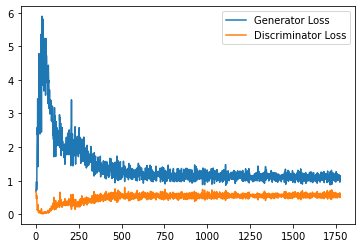

Step 36000: Generator loss: 1.0871120433807373, discriminator loss: 0.5668230345249176


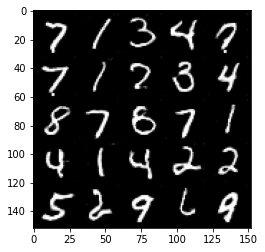

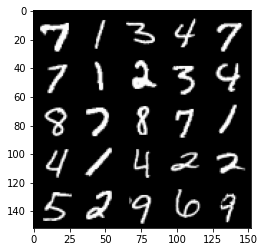

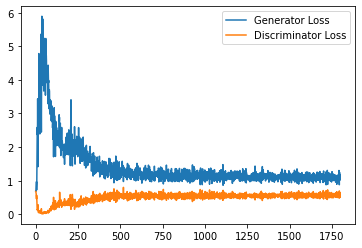

Step 36500: Generator loss: 1.1083070529699326, discriminator loss: 0.5635020267367363


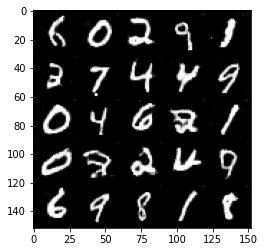

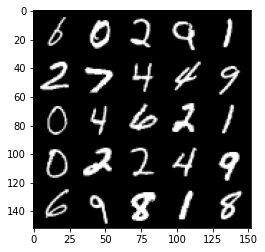

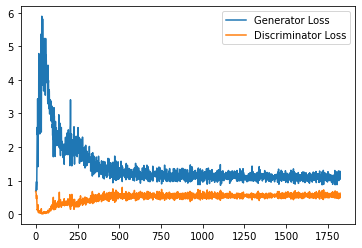

Step 37000: Generator loss: 1.1404542115926743, discriminator loss: 0.5578148099184036


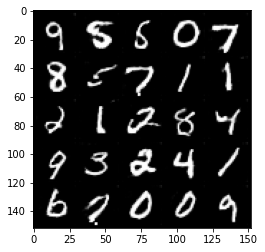

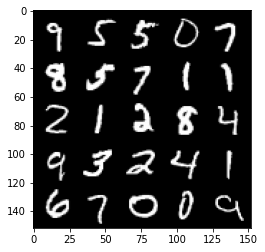

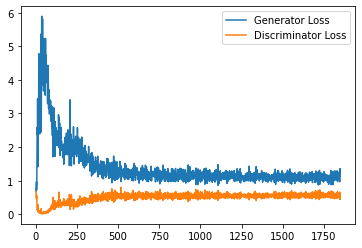

Step 37500: Generator loss: 1.1032726604938508, discriminator loss: 0.5652477164268493


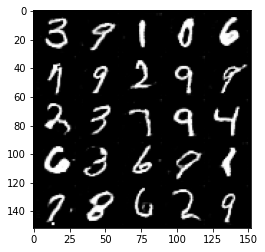

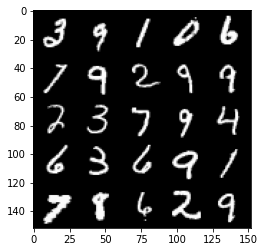

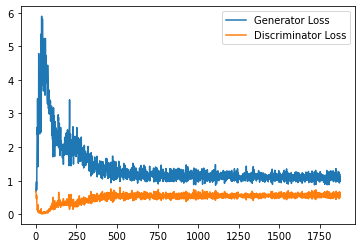

Step 38000: Generator loss: 1.0974143115282058, discriminator loss: 0.5614578478336334


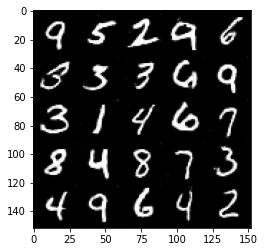

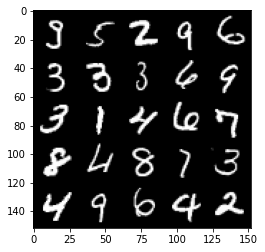

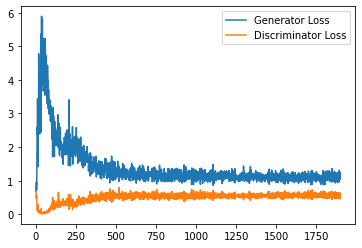

Step 38500: Generator loss: 1.1030659942626952, discriminator loss: 0.5655423157215118


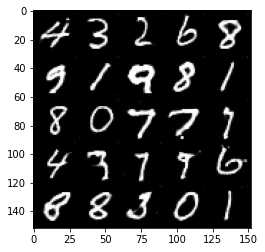

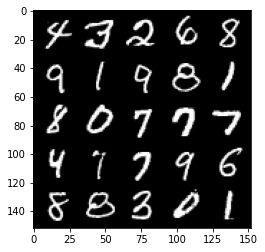

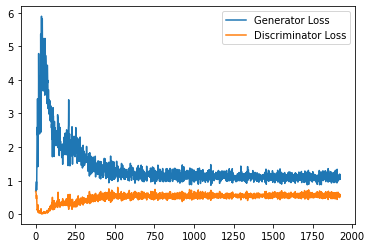

Step 39000: Generator loss: 1.074354152083397, discriminator loss: 0.5646553450226783


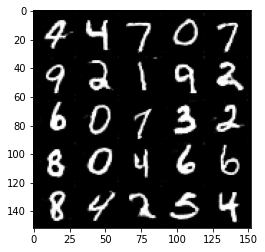

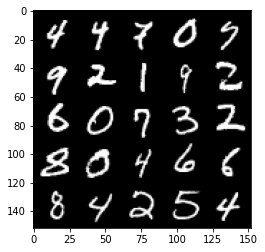

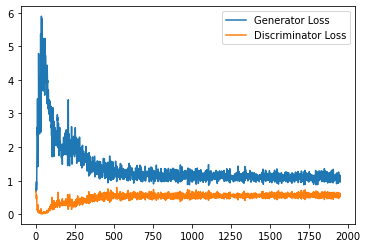

Step 39500: Generator loss: 1.0936730144023896, discriminator loss: 0.5636709785461426


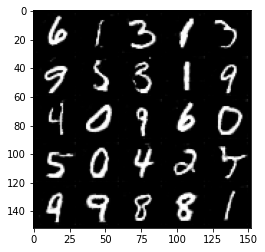

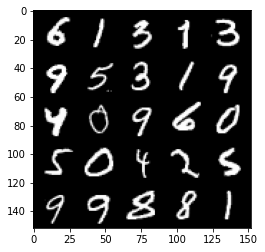

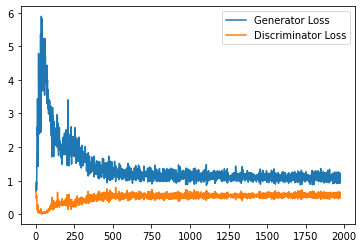

Step 40000: Generator loss: 1.1055175825357437, discriminator loss: 0.5697865517735481


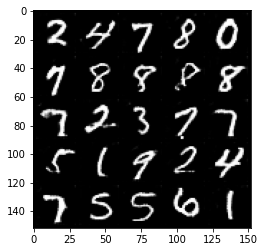

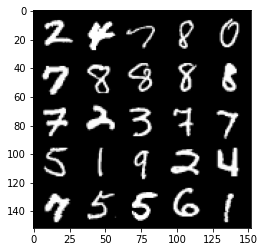

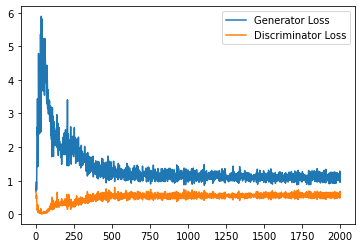

Step 40500: Generator loss: 1.1160865672826767, discriminator loss: 0.5562776989936828


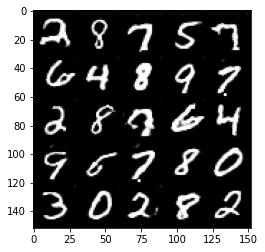

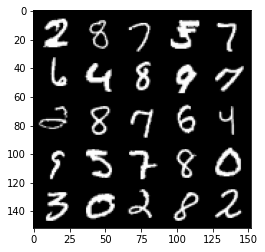

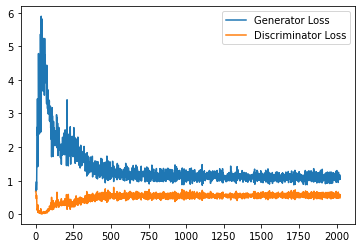

Step 41000: Generator loss: 1.0783422328233718, discriminator loss: 0.558398472726345


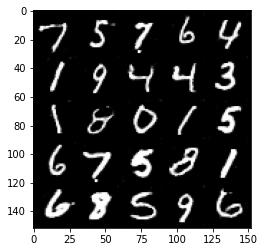

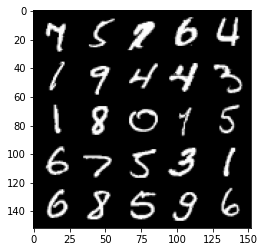

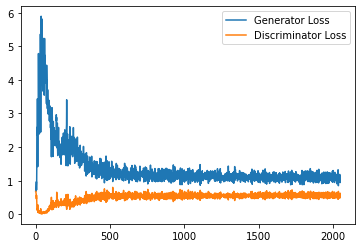

Step 41500: Generator loss: 1.1146262699365617, discriminator loss: 0.5623338591456414


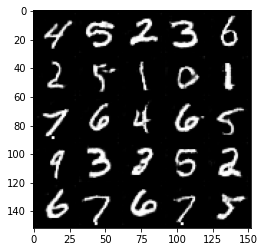

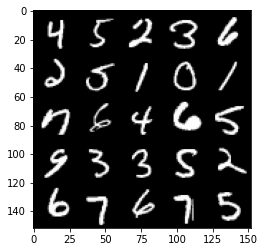

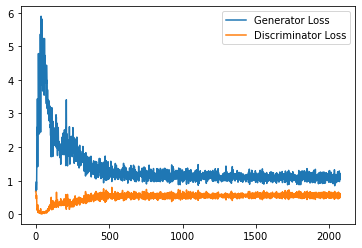

Step 42000: Generator loss: 1.1138226828575135, discriminator loss: 0.5662616809010506


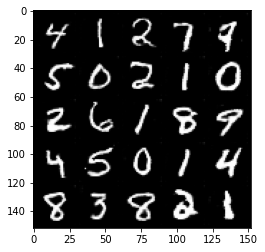

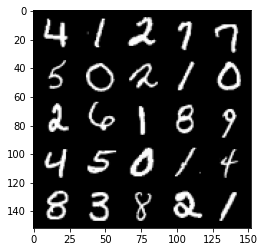

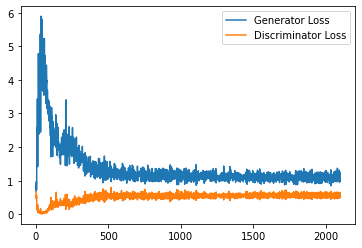

Step 42500: Generator loss: 1.0972466946840287, discriminator loss: 0.5574279146194459


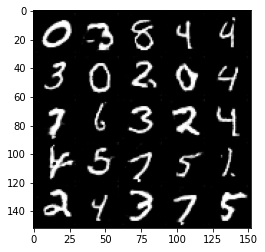

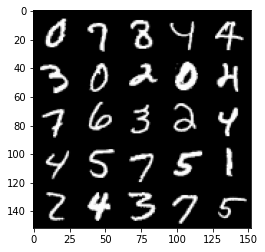

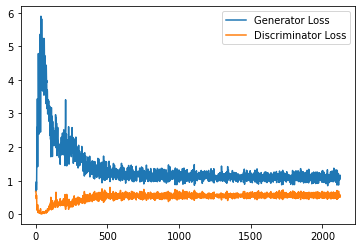

Step 43000: Generator loss: 1.1235384751558304, discriminator loss: 0.5616624304652214


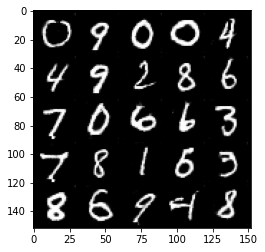

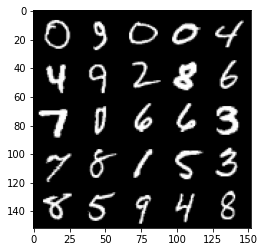

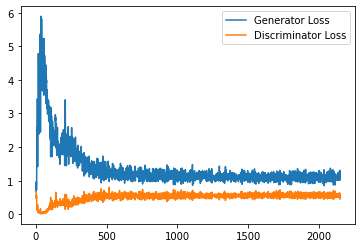

Step 43500: Generator loss: 1.1011467175483705, discriminator loss: 0.572061132311821


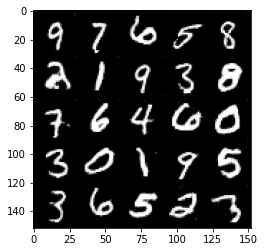

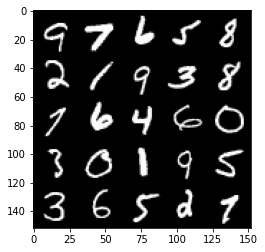

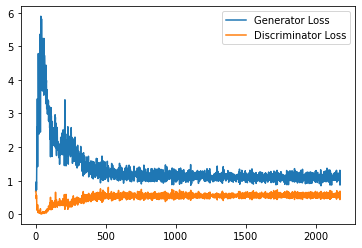

Step 44000: Generator loss: 1.0830689083337783, discriminator loss: 0.5642509318590164


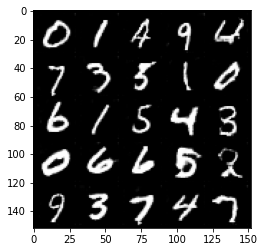

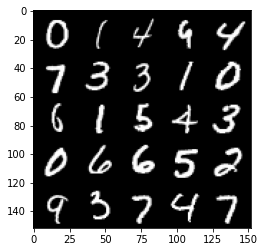

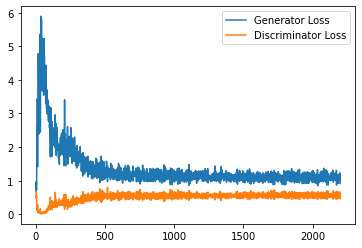

Step 44500: Generator loss: 1.1149632252454758, discriminator loss: 0.562514370560646


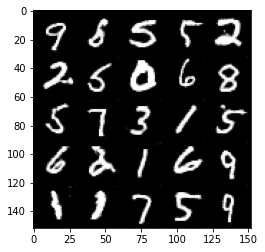

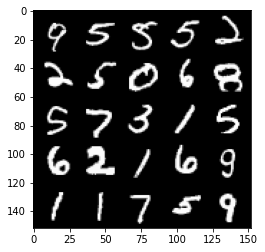

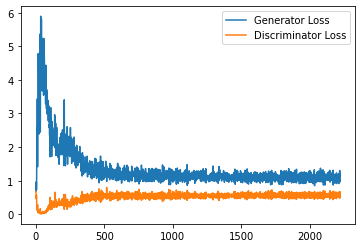

Step 45000: Generator loss: 1.1257042185068131, discriminator loss: 0.5612849036455154


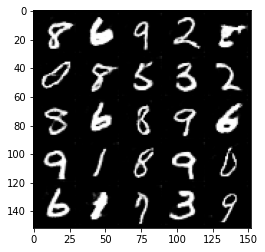

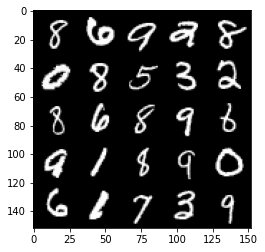

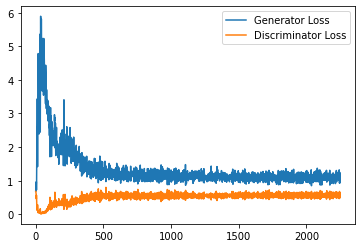

Step 45500: Generator loss: 1.1098882052898407, discriminator loss: 0.5594988757967949


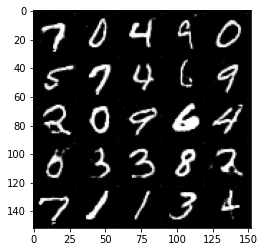

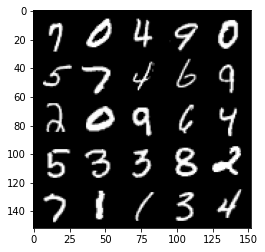

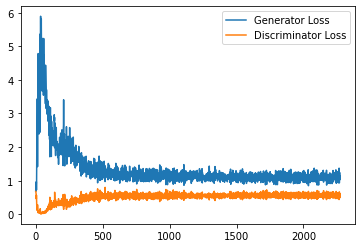

Step 46000: Generator loss: 1.097407642364502, discriminator loss: 0.5614031147956848


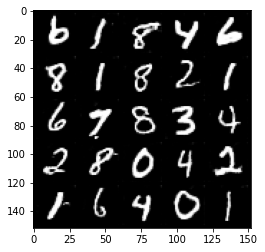

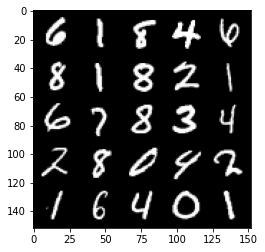

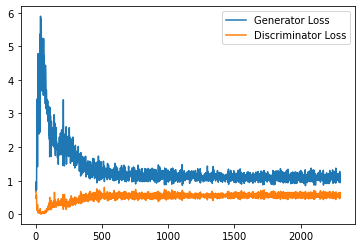

Step 46500: Generator loss: 1.084788596391678, discriminator loss: 0.5579949715137482


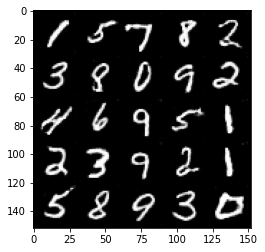

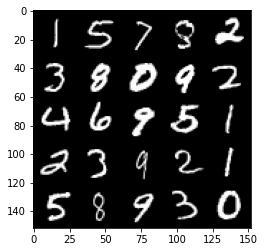

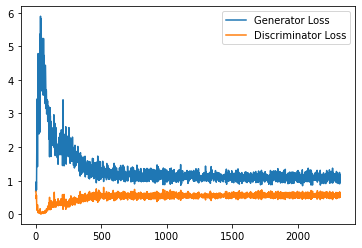

Step 47000: Generator loss: 1.1039425156116485, discriminator loss: 0.559059835612774


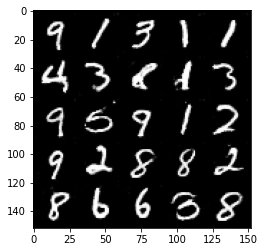

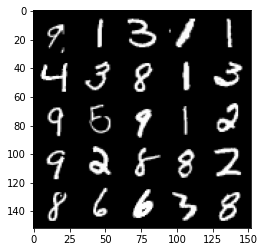

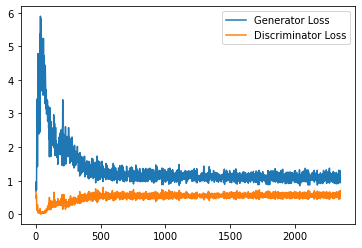

Step 47500: Generator loss: 1.1058198053836823, discriminator loss: 0.5573035033941269


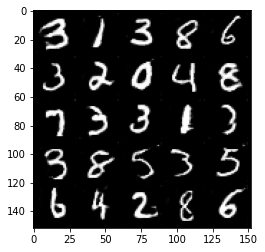

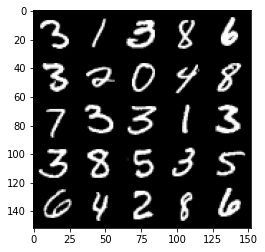

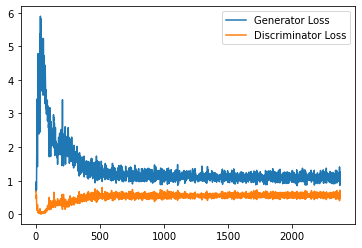

Step 48000: Generator loss: 1.0901758916378022, discriminator loss: 0.5625225027799606


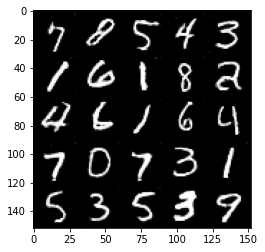

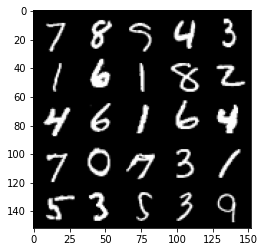

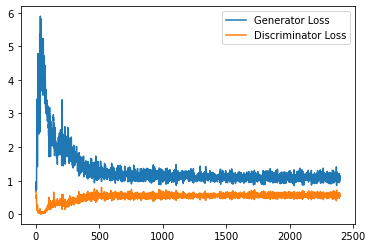

Step 48500: Generator loss: 1.1092996537685393, discriminator loss: 0.559450866997242


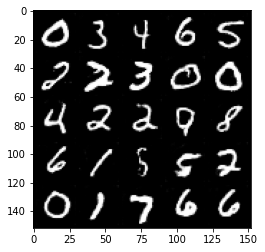

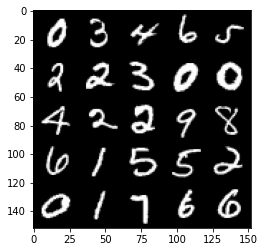

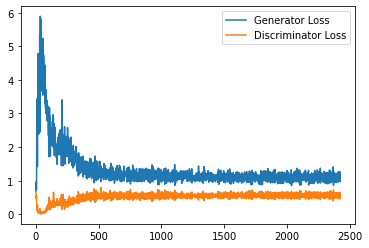

Step 49000: Generator loss: 1.1096887174844743, discriminator loss: 0.558466622710228


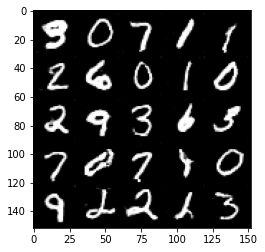

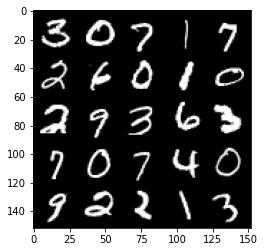

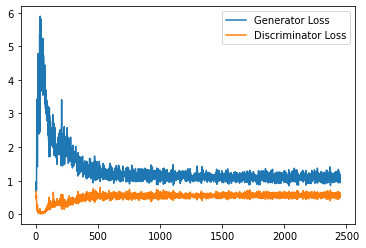

Step 49500: Generator loss: 1.1179581630229949, discriminator loss: 0.5559919052124024


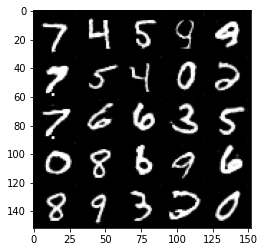

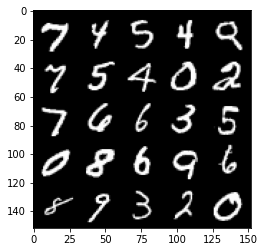

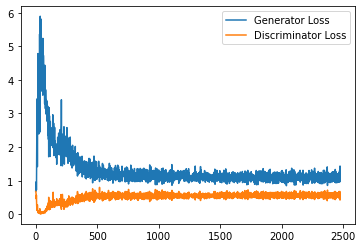

Step 50000: Generator loss: 1.119063139796257, discriminator loss: 0.5662181539535522


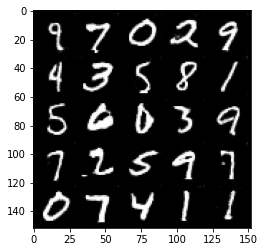

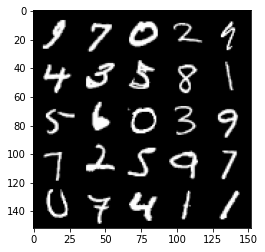

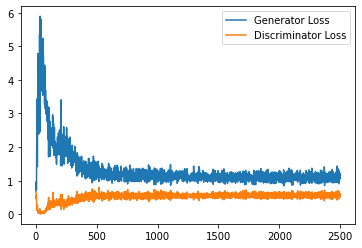

Step 50500: Generator loss: 1.0876050242185593, discriminator loss: 0.5627892936468124


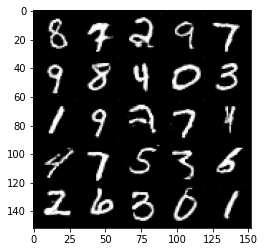

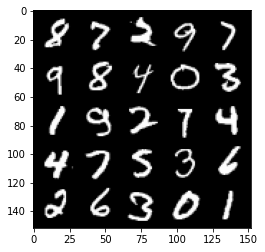

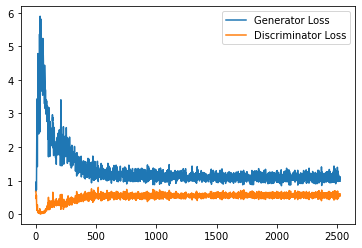

Step 51000: Generator loss: 1.0866081204414368, discriminator loss: 0.5597047007083893


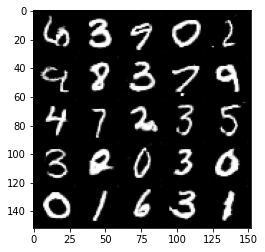

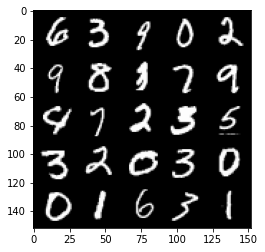

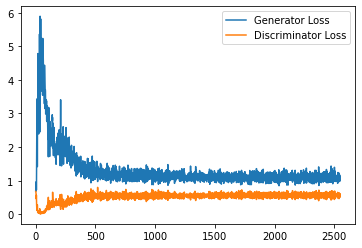

Step 51500: Generator loss: 1.1080084000825883, discriminator loss: 0.5650786325931549


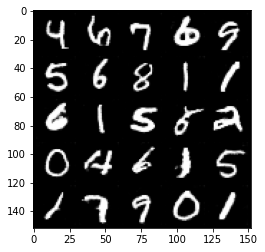

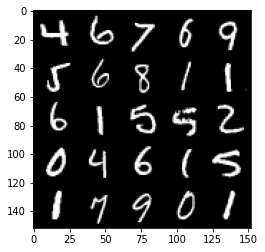

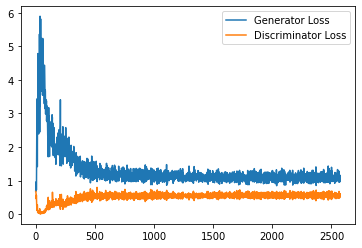

Step 52000: Generator loss: 1.1041994429826736, discriminator loss: 0.5557305261492729


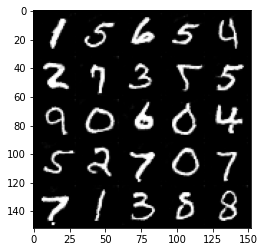

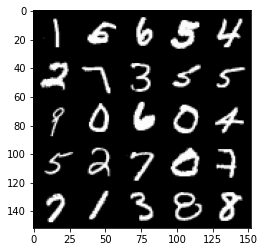

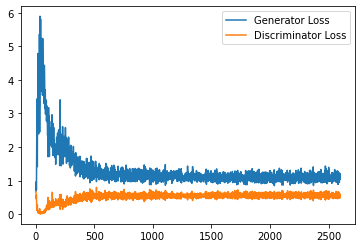

Step 52500: Generator loss: 1.129793157339096, discriminator loss: 0.5513677781224251


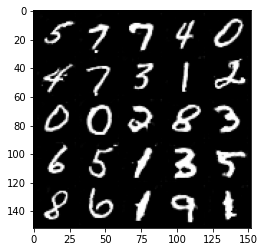

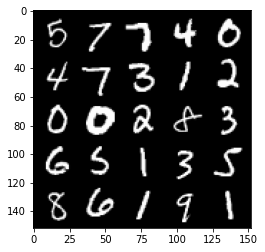

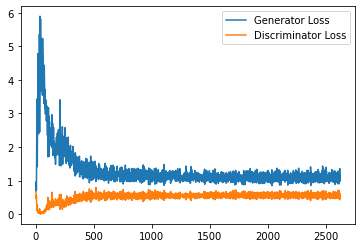

Step 53000: Generator loss: 1.0838302249908447, discriminator loss: 0.5637205811142921


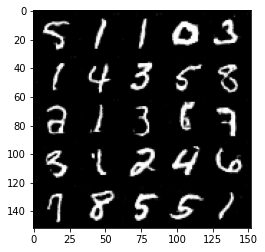

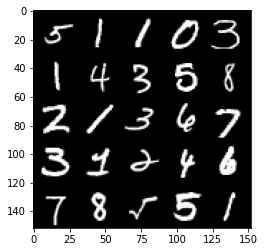

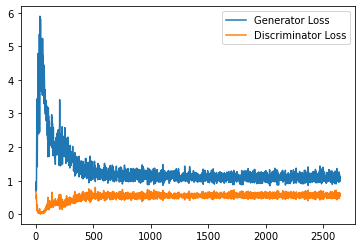

Step 53500: Generator loss: 1.1462583086490632, discriminator loss: 0.5548160789608956


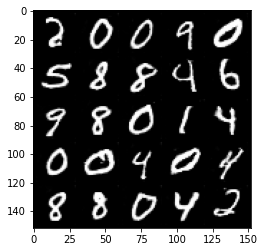

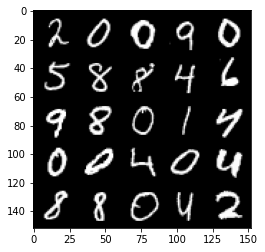

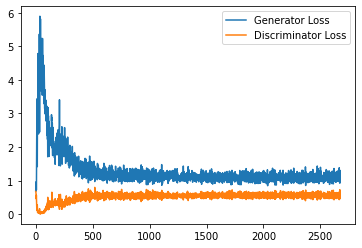

Step 54000: Generator loss: 1.1005548959970475, discriminator loss: 0.5585459268093109


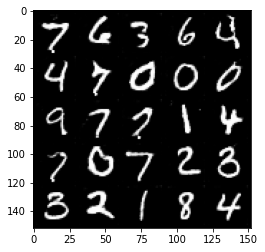

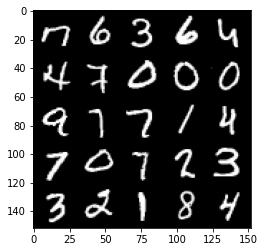

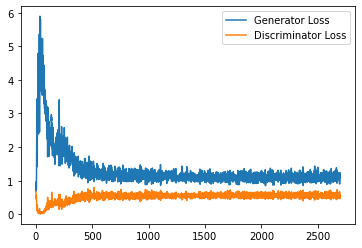

Step 54500: Generator loss: 1.1432899899482727, discriminator loss: 0.5506656090021134


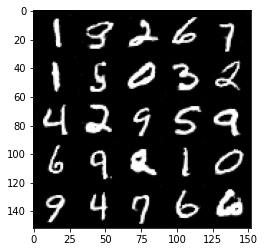

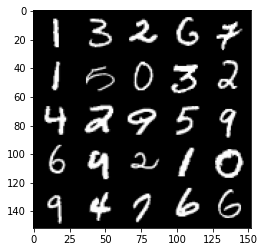

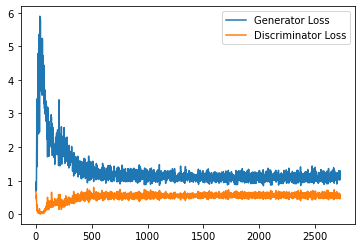

Step 55000: Generator loss: 1.120005087018013, discriminator loss: 0.55579810577631


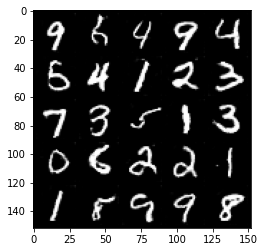

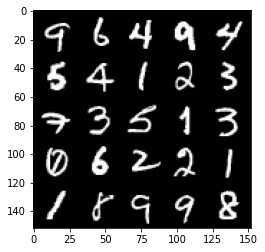

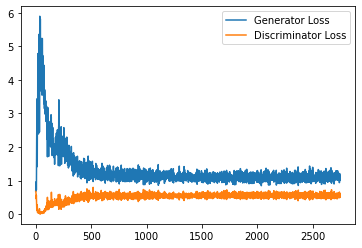

Step 55500: Generator loss: 1.119526550769806, discriminator loss: 0.5462286396622658


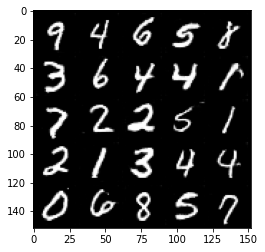

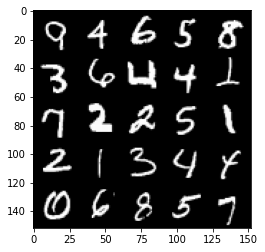

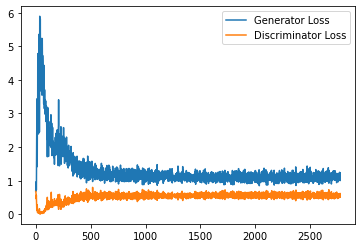

Step 56000: Generator loss: 1.1389414958953858, discriminator loss: 0.5619285440444947


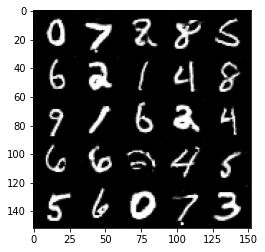

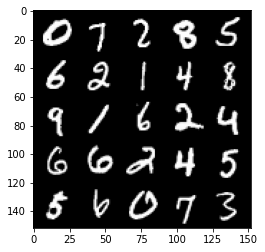

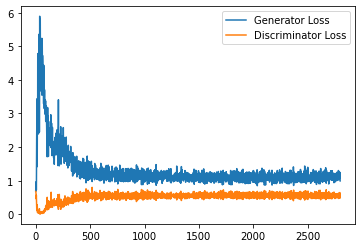

Step 56500: Generator loss: 1.1062121312618256, discriminator loss: 0.550760643362999


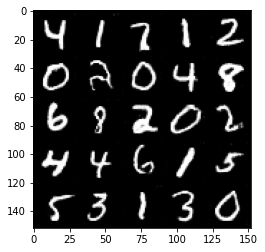

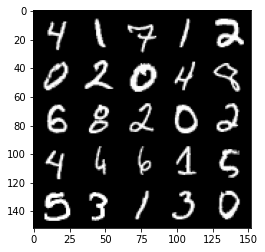

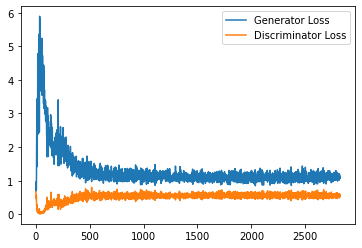

Step 57000: Generator loss: 1.1319216408729553, discriminator loss: 0.5516138593554497


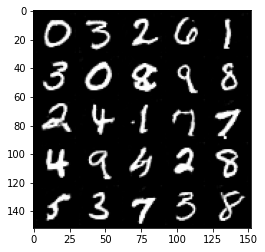

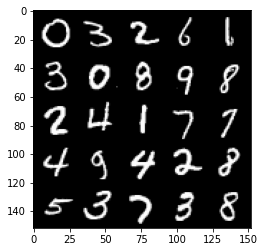

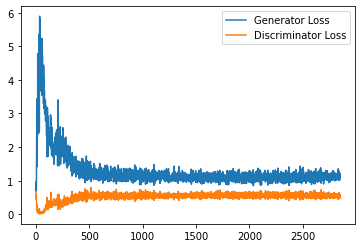

Step 57500: Generator loss: 1.1326321729421616, discriminator loss: 0.555018846809864


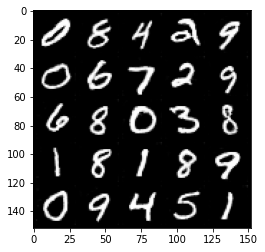

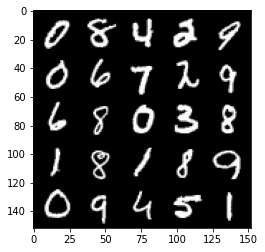

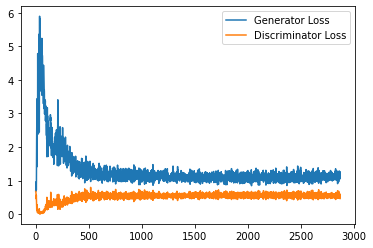

Step 58000: Generator loss: 1.1030850143432618, discriminator loss: 0.5583323340415954


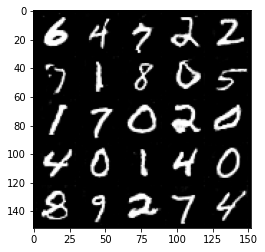

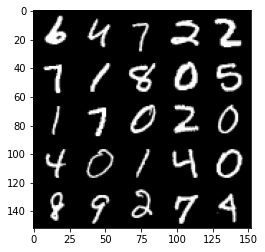

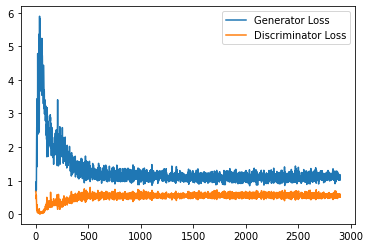

Step 58500: Generator loss: 1.1075699523687363, discriminator loss: 0.5542604333162308


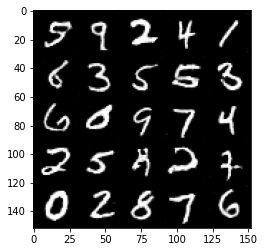

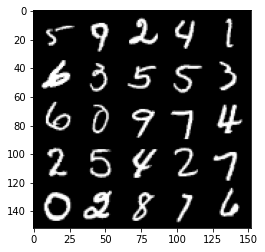

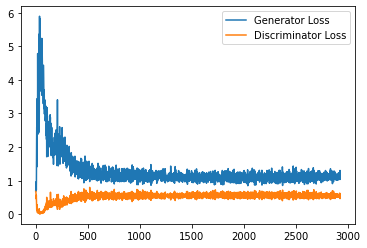

Step 59000: Generator loss: 1.1294102790355682, discriminator loss: 0.5592343772053718


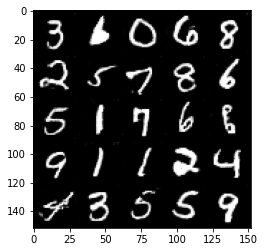

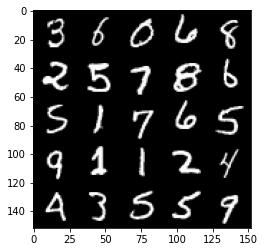

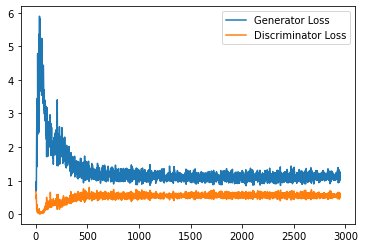

Step 59500: Generator loss: 1.113943495988846, discriminator loss: 0.5590776360034942


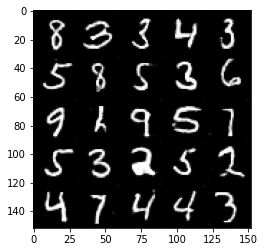

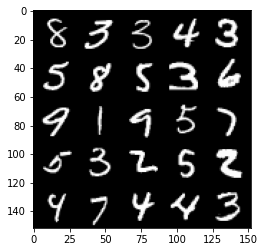

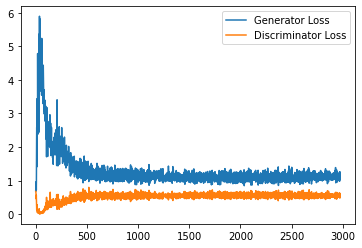

Step 60000: Generator loss: 1.1077842257022859, discriminator loss: 0.5589282936453819


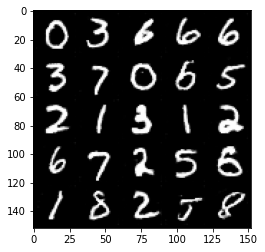

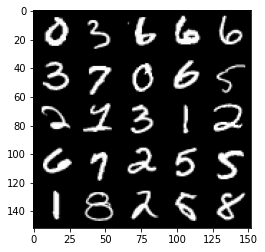

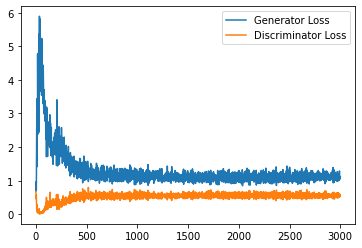

Step 60500: Generator loss: 1.119682542681694, discriminator loss: 0.560724307000637


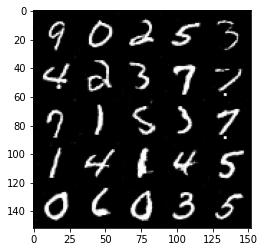

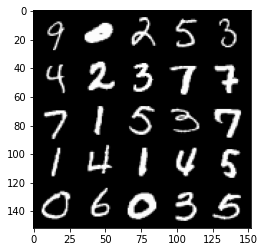

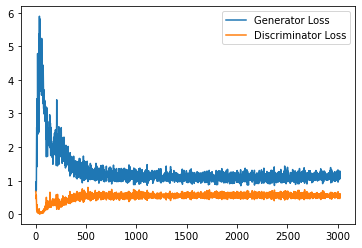

Step 61000: Generator loss: 1.125385351419449, discriminator loss: 0.5657820017933846


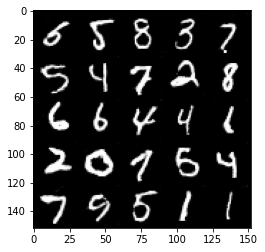

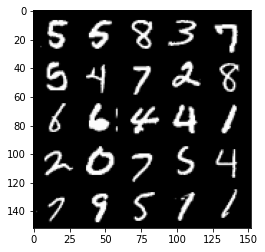

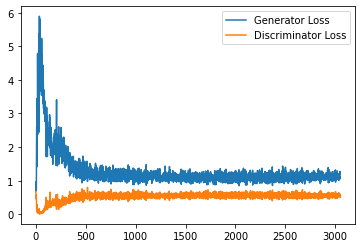

Step 61500: Generator loss: 1.1005788465738298, discriminator loss: 0.5663302426338196


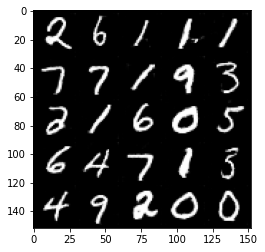

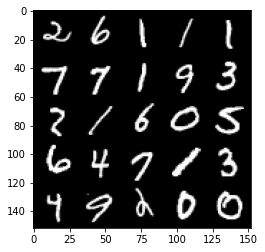

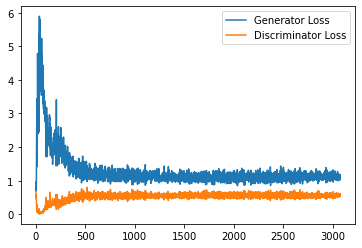

Step 62000: Generator loss: 1.127652419924736, discriminator loss: 0.564906568646431


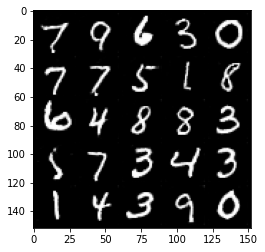

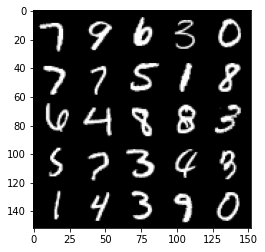

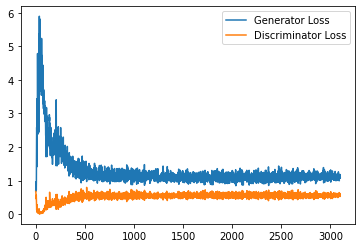

Step 62500: Generator loss: 1.117876732468605, discriminator loss: 0.5600618177056312


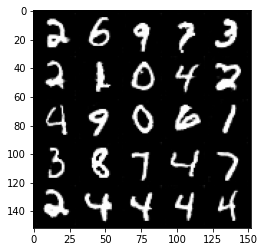

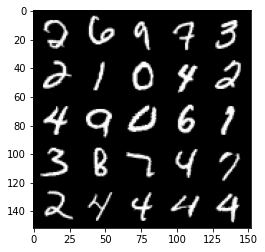

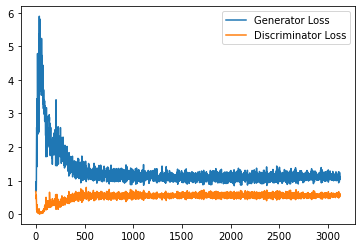

Step 63000: Generator loss: 1.0974436613321303, discriminator loss: 0.561849845290184


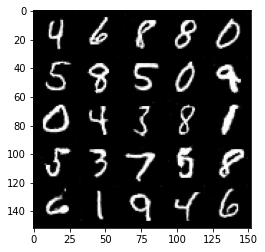

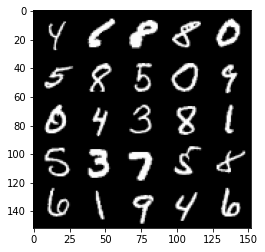

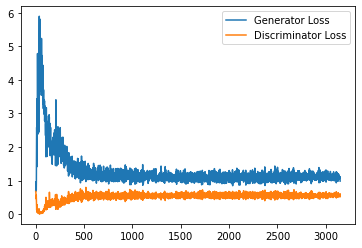

Step 63500: Generator loss: 1.1026418281793595, discriminator loss: 0.5675167546272278


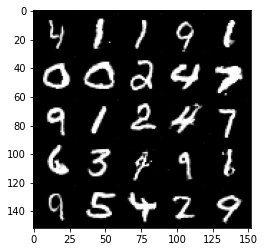

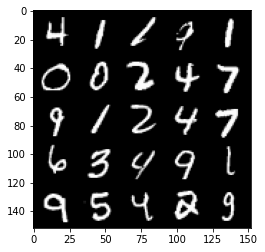

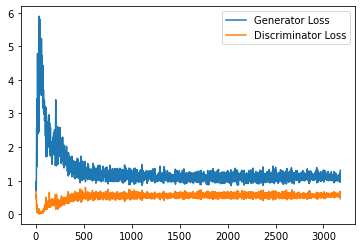

Step 64000: Generator loss: 1.1050190839767455, discriminator loss: 0.5725008737444878


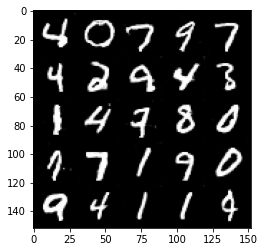

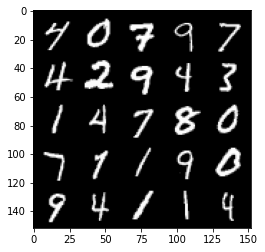

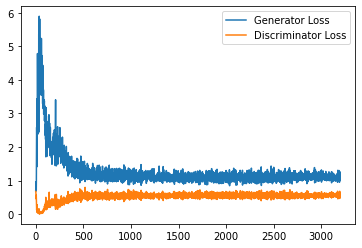

Step 64500: Generator loss: 1.1120130560398103, discriminator loss: 0.5703429236412049


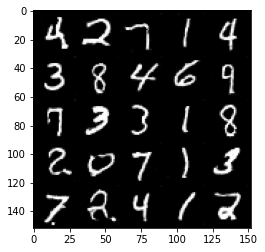

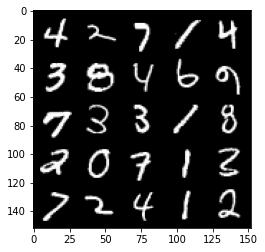

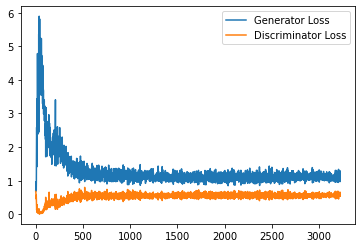

Step 65000: Generator loss: 1.0929469068050384, discriminator loss: 0.5678407346606255


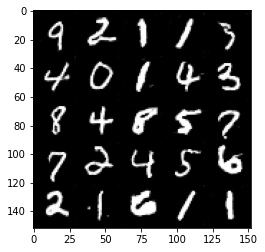

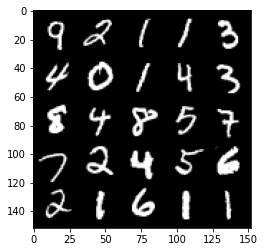

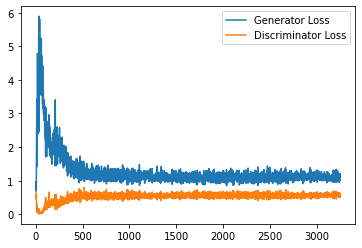

Step 65500: Generator loss: 1.0990665360689162, discriminator loss: 0.5700633708834648


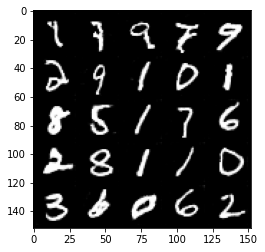

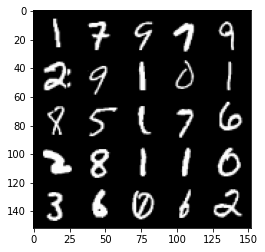

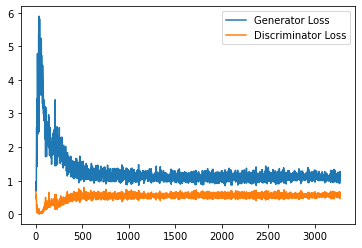

Step 66000: Generator loss: 1.087578474998474, discriminator loss: 0.5703735488057137


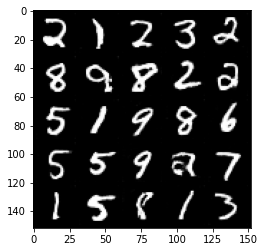

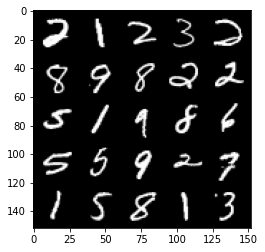

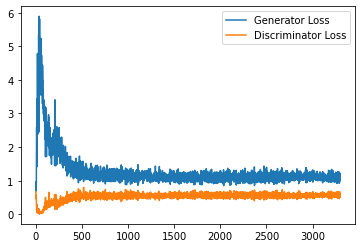

Step 66500: Generator loss: 1.1037241044044495, discriminator loss: 0.5744044545292855


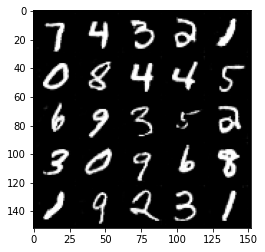

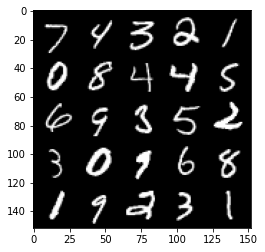

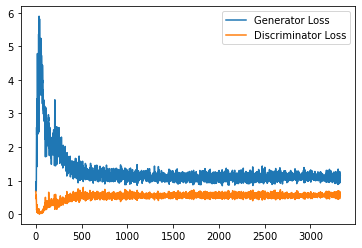

Step 67000: Generator loss: 1.0895314705371857, discriminator loss: 0.5756291180253029


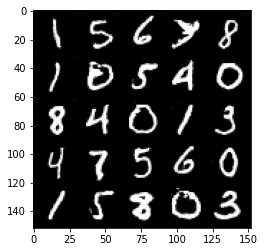

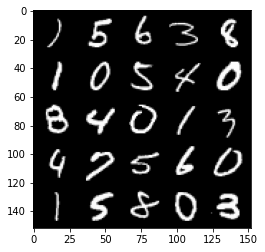

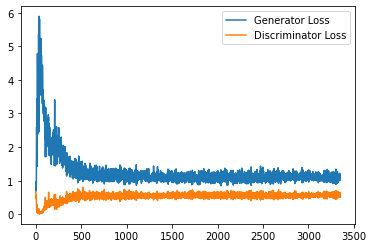

Step 67500: Generator loss: 1.0834653301239014, discriminator loss: 0.5755655719041824


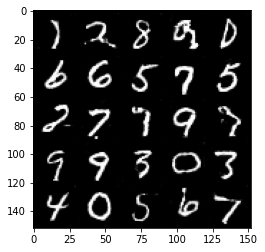

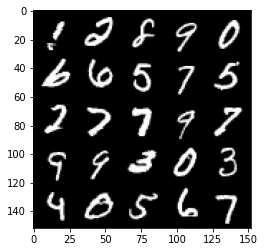

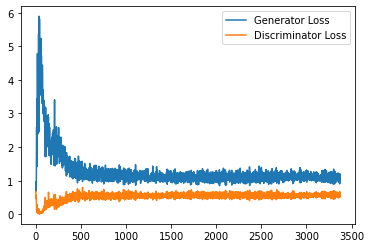

Step 68000: Generator loss: 1.09206483066082, discriminator loss: 0.5817590996623039


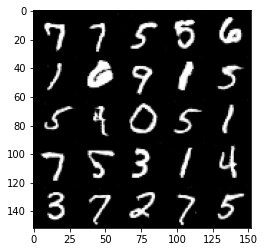

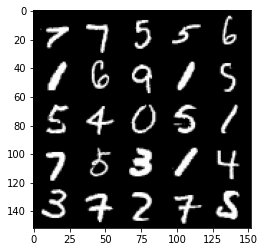

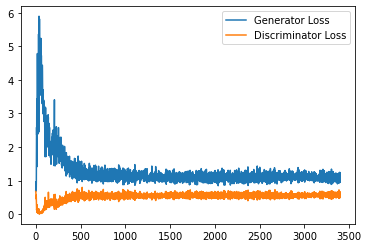

Step 68500: Generator loss: 1.1101303944587708, discriminator loss: 0.5690263578295708


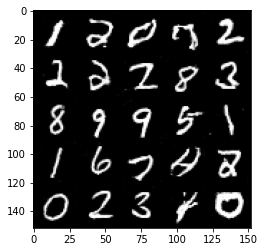

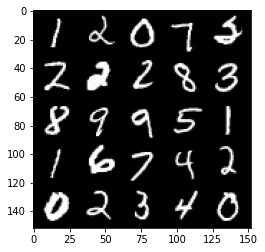

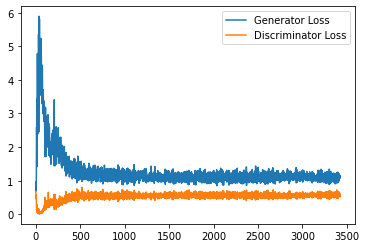

Step 69000: Generator loss: 1.0995762927532196, discriminator loss: 0.5773921862840653


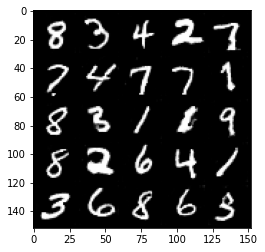

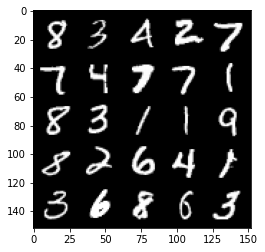

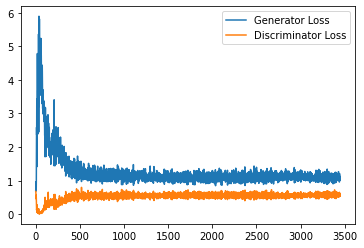

Step 69500: Generator loss: 1.080805539727211, discriminator loss: 0.5737248284220695


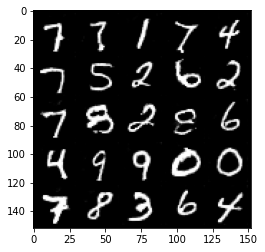

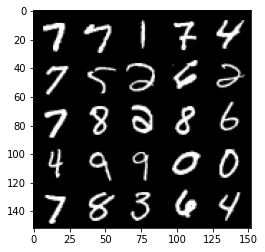

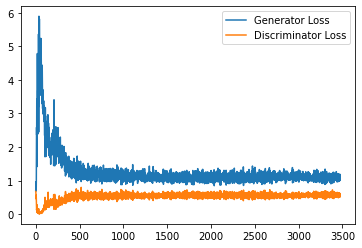

Step 70000: Generator loss: 1.0808114717006683, discriminator loss: 0.5819079511761666


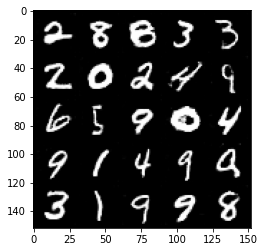

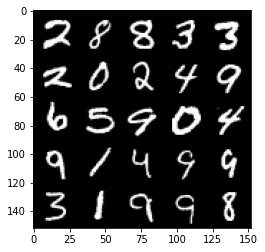

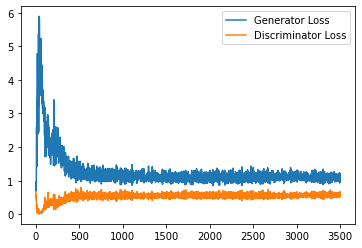

Step 70500: Generator loss: 1.0974912184476853, discriminator loss: 0.574984420478344


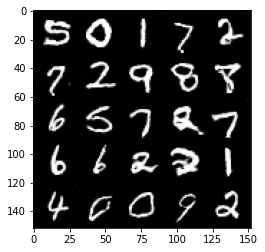

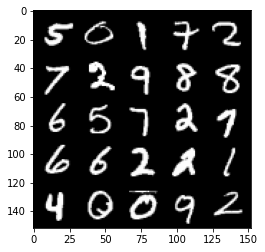

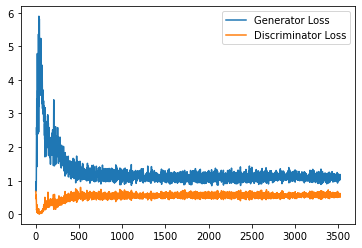

Step 71000: Generator loss: 1.0701881419420243, discriminator loss: 0.586303989648819


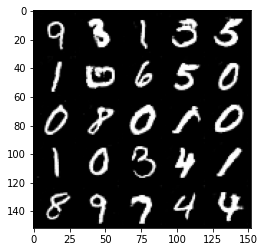

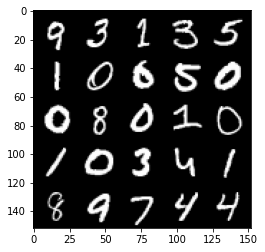

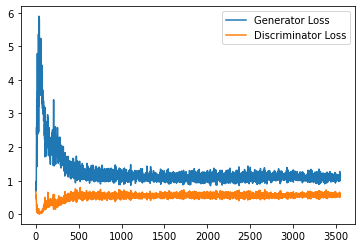

Step 71500: Generator loss: 1.0827709399461747, discriminator loss: 0.5934630318284034


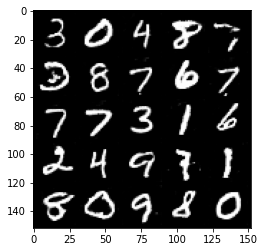

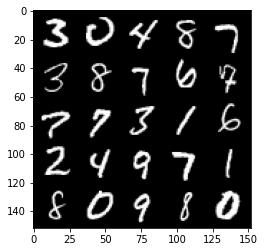

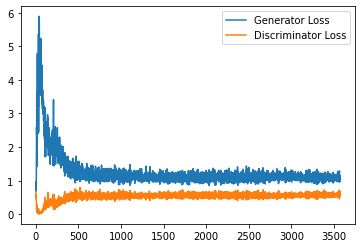

Step 72000: Generator loss: 1.065671273469925, discriminator loss: 0.5803624429702758


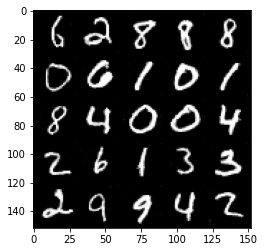

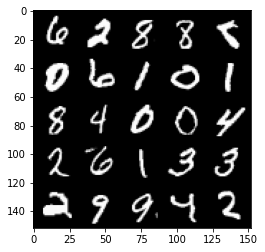

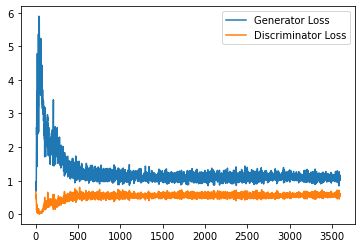

Step 72500: Generator loss: 1.088263522028923, discriminator loss: 0.5803360885977745


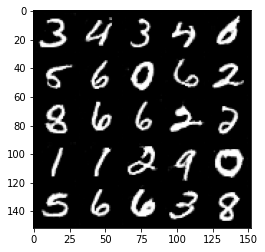

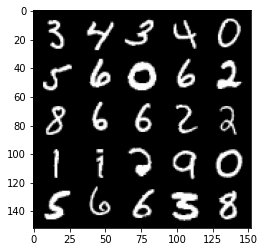

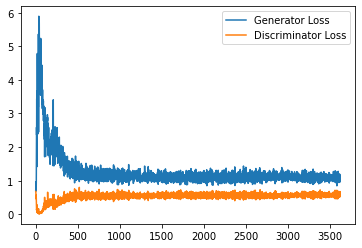

Step 73000: Generator loss: 1.0710179543495177, discriminator loss: 0.5775606080293655


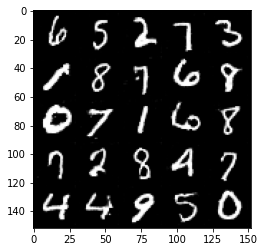

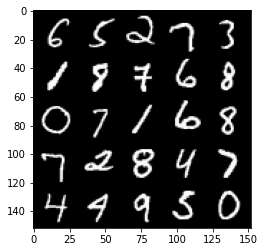

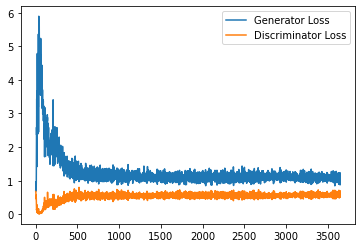

Step 73500: Generator loss: 1.0804170432090758, discriminator loss: 0.575775105714798


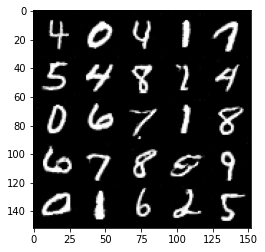

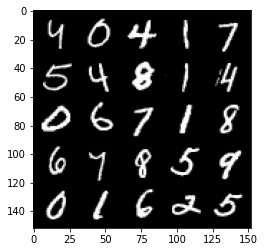

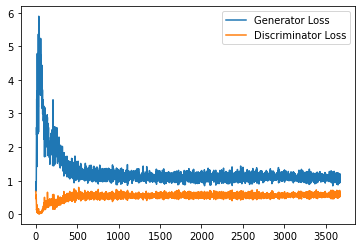

Step 74000: Generator loss: 1.0899621613621713, discriminator loss: 0.5870984527468681


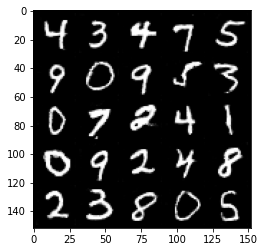

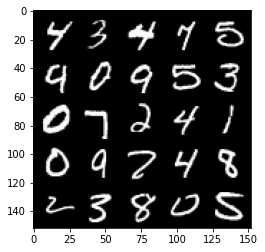

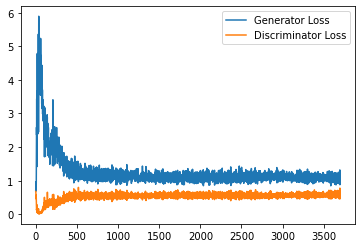

Step 74500: Generator loss: 1.0856975827217101, discriminator loss: 0.5850886813402176


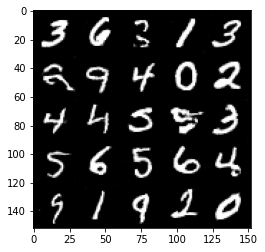

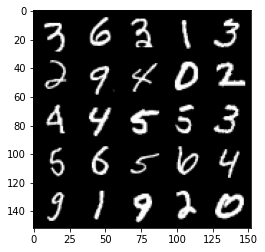

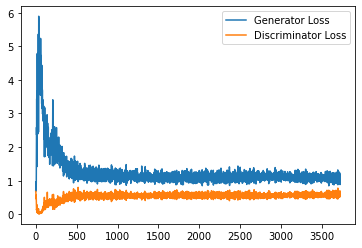

Step 75000: Generator loss: 1.0748668438196183, discriminator loss: 0.5842128769159317


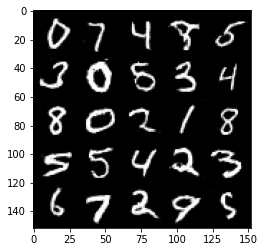

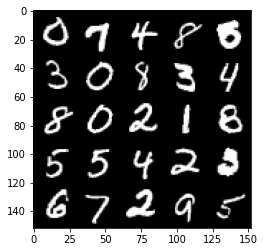

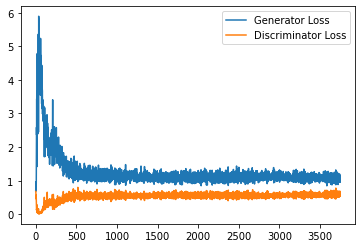

Step 75500: Generator loss: 1.0642870519161225, discriminator loss: 0.5828761003613472


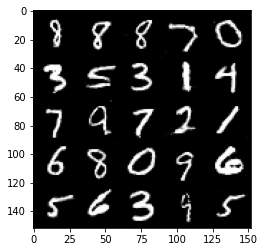

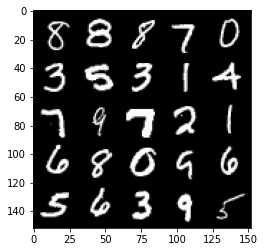

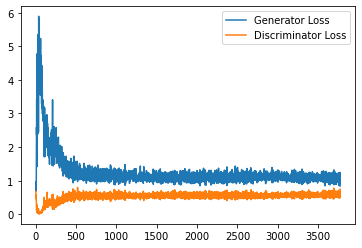

Step 76000: Generator loss: 1.0813968784809112, discriminator loss: 0.5849826158881187


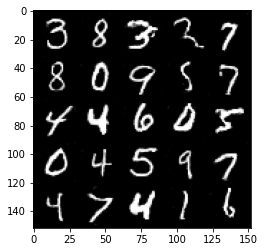

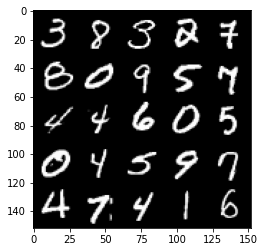

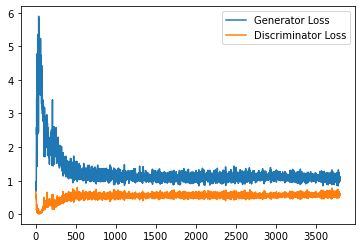

Step 76500: Generator loss: 1.0660275843143463, discriminator loss: 0.5796313116550446


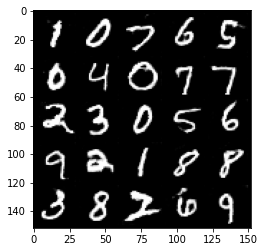

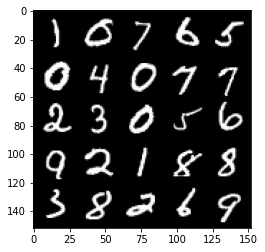

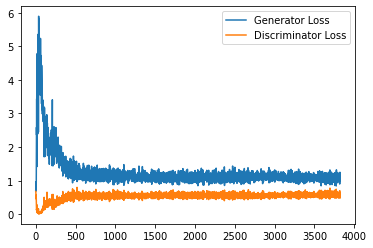

Step 77000: Generator loss: 1.0848332914113998, discriminator loss: 0.5895132833719253


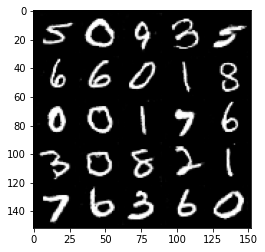

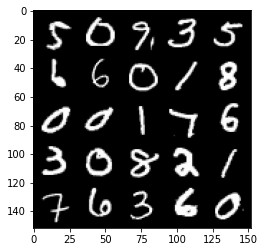

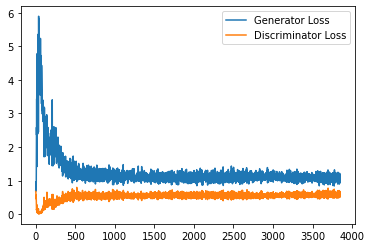

Step 77500: Generator loss: 1.0534464542865754, discriminator loss: 0.5860960973501206


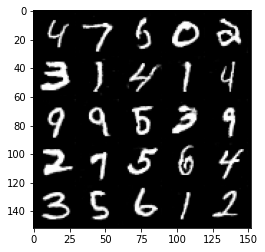

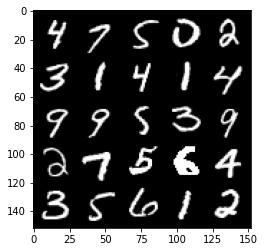

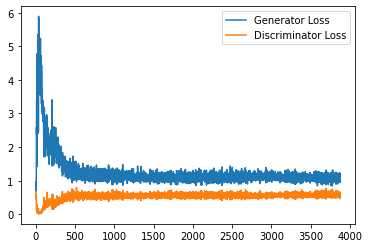

Step 78000: Generator loss: 1.0636810127496719, discriminator loss: 0.5822740607261657


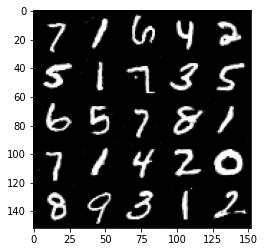

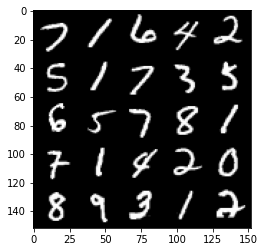

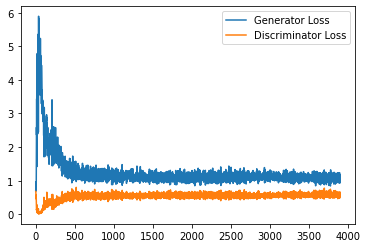

Step 78500: Generator loss: 1.0698764568567276, discriminator loss: 0.5850209740400314


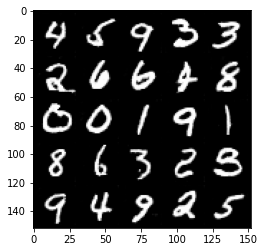

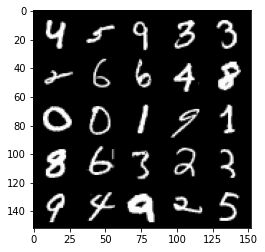

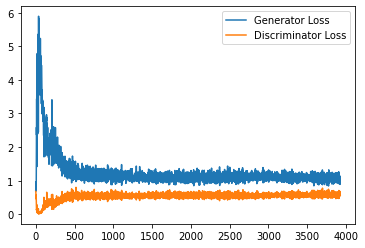

Step 79000: Generator loss: 1.0665797988176347, discriminator loss: 0.5832396402955056


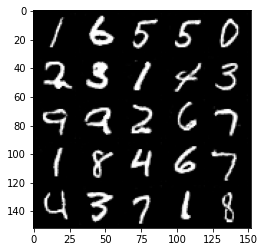

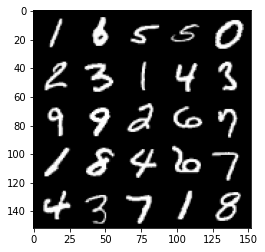

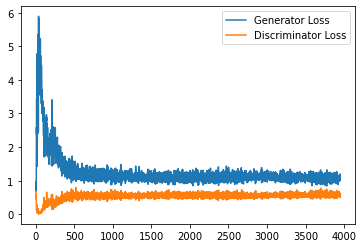

Step 79500: Generator loss: 1.0676929680109024, discriminator loss: 0.5908817108869553


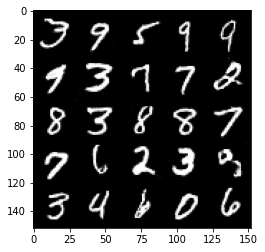

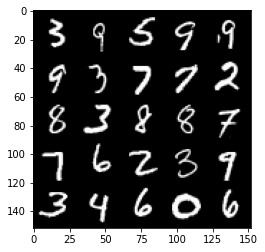

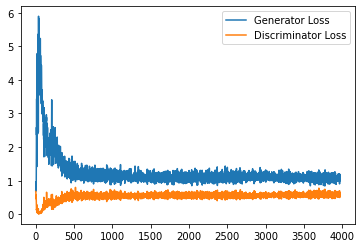

Step 80000: Generator loss: 1.046811091184616, discriminator loss: 0.5953452520370484


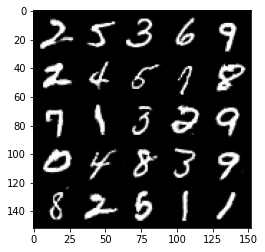

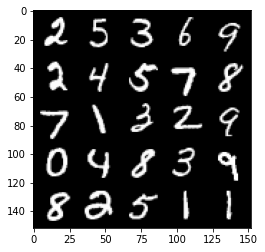

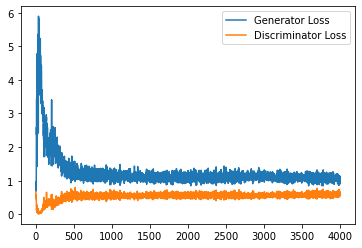

Step 80500: Generator loss: 1.0599792256355285, discriminator loss: 0.5878595429658889


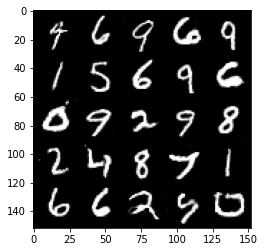

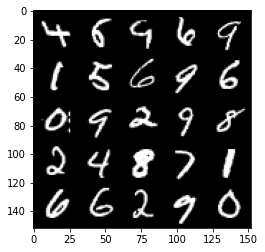

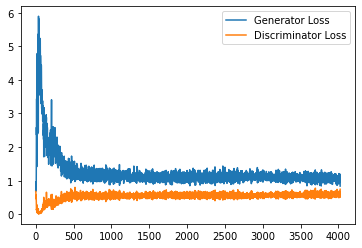

Step 81000: Generator loss: 1.062848412513733, discriminator loss: 0.5840802684426307


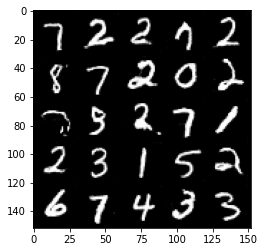

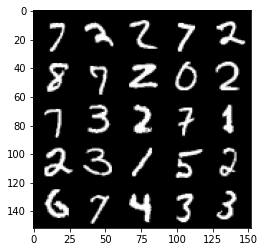

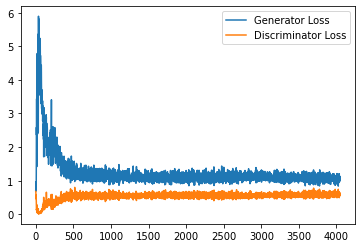

Step 81500: Generator loss: 1.05039921271801, discriminator loss: 0.5969404697418212


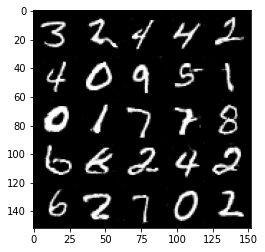

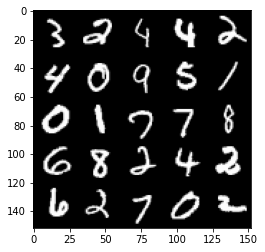

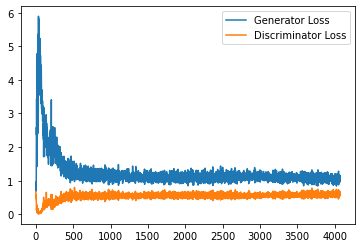

Step 82000: Generator loss: 1.0648623884916306, discriminator loss: 0.5926316583752632


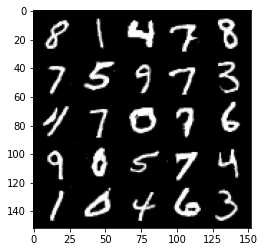

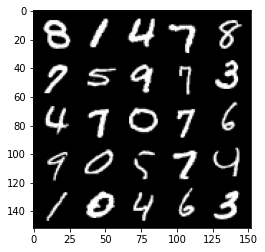

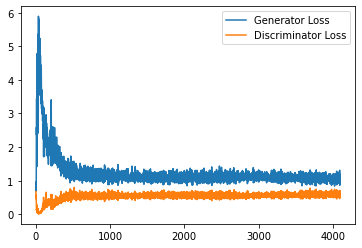

Step 82500: Generator loss: 1.0633413449525833, discriminator loss: 0.58699159938097


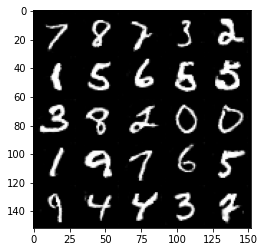

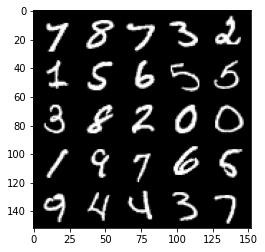

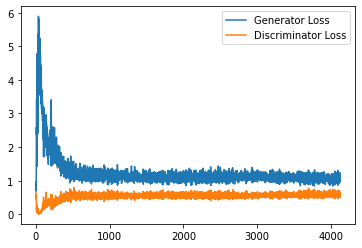

Step 83000: Generator loss: 1.0998689980506897, discriminator loss: 0.5785108649134636


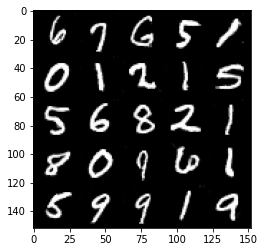

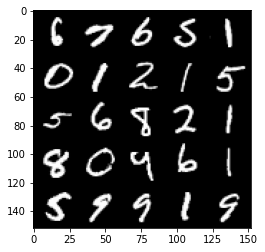

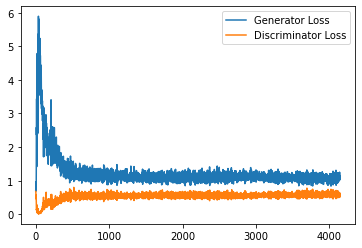

Step 83500: Generator loss: 1.0710218831300735, discriminator loss: 0.5910879926085472


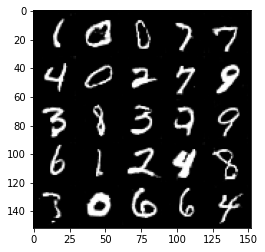

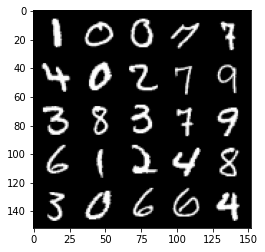

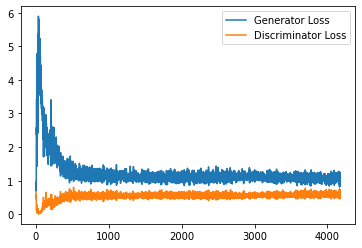

Step 84000: Generator loss: 1.0436951217651367, discriminator loss: 0.5900956818461418


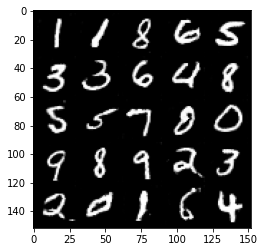

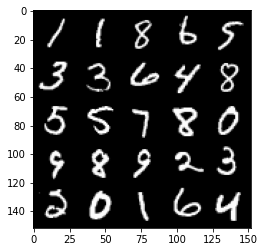

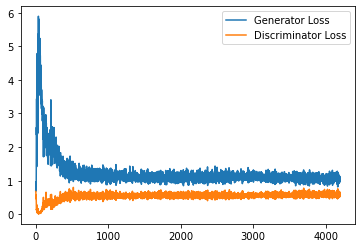

Step 84500: Generator loss: 1.067193454027176, discriminator loss: 0.5850259226560592


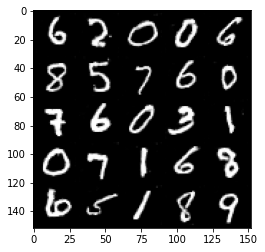

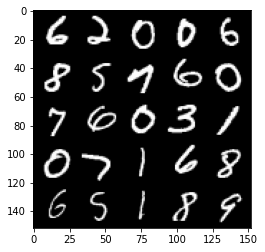

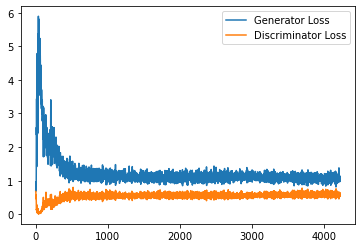

Step 85000: Generator loss: 1.0407081266641618, discriminator loss: 0.5883118833303451


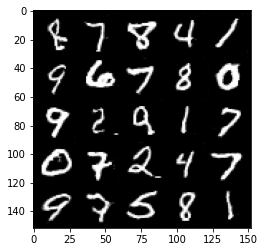

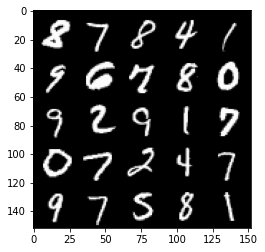

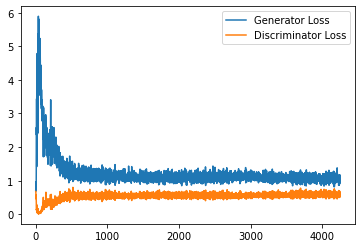

Step 85500: Generator loss: 1.058379503250122, discriminator loss: 0.5846253036856651


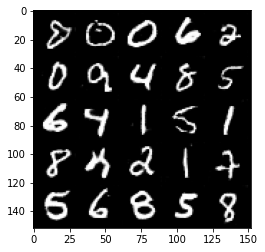

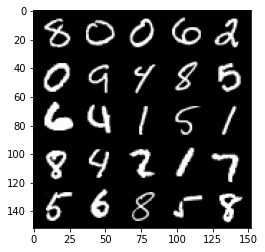

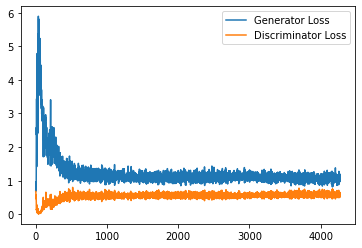

Step 86000: Generator loss: 1.0745522245168686, discriminator loss: 0.5882352421879768


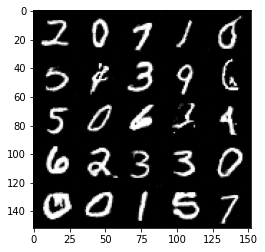

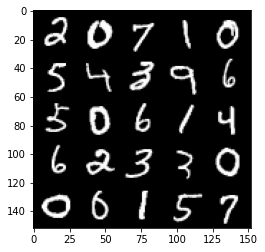

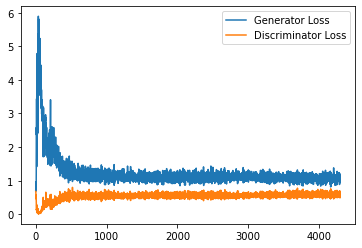

Step 86500: Generator loss: 1.0696135761737824, discriminator loss: 0.5907455604076386


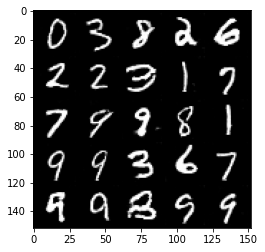

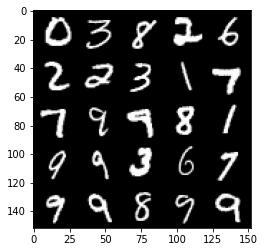

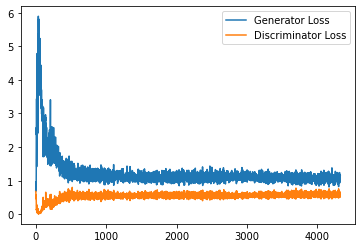

Step 87000: Generator loss: 1.0692526760101317, discriminator loss: 0.5836756395697593


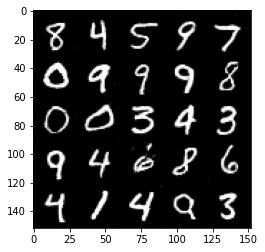

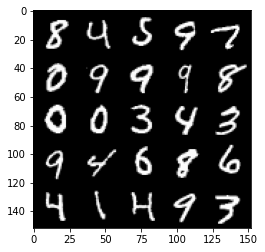

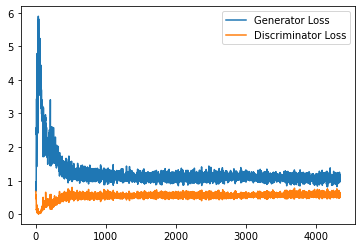

Step 87500: Generator loss: 1.0457229211330414, discriminator loss: 0.5971370694041253


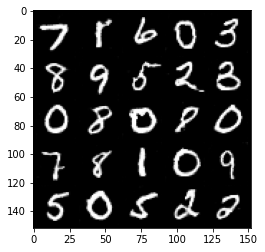

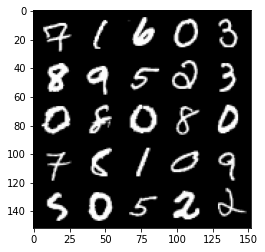

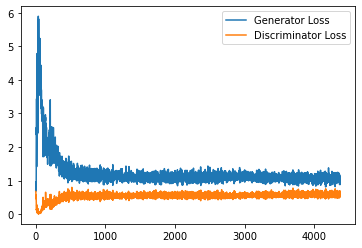

Step 88000: Generator loss: 1.0517167969942094, discriminator loss: 0.5840829865336418


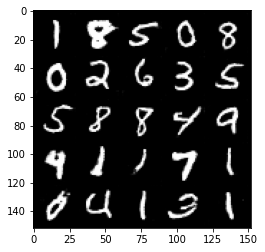

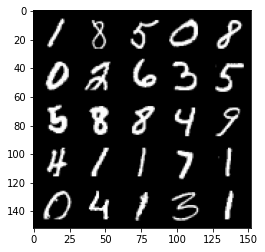

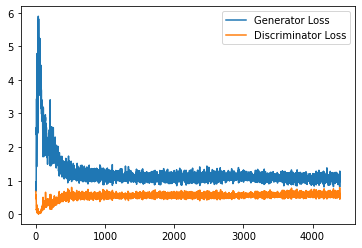

Step 88500: Generator loss: 1.0569121299982072, discriminator loss: 0.5869914021492004


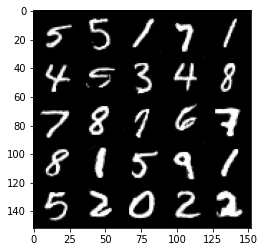

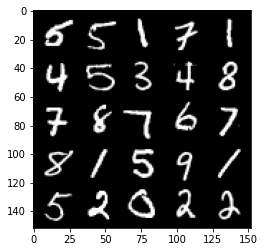

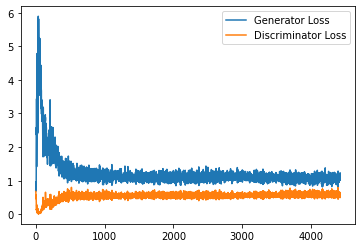

Step 89000: Generator loss: 1.0366004906892776, discriminator loss: 0.5932569906711579


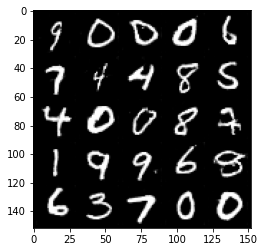

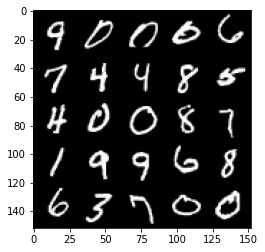

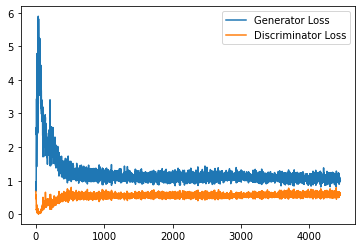

Step 89500: Generator loss: 1.0337540959119798, discriminator loss: 0.5911466631293297


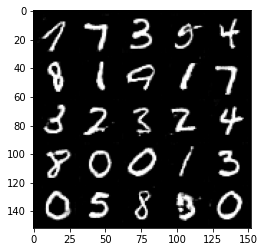

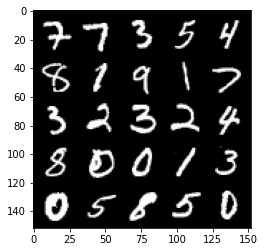

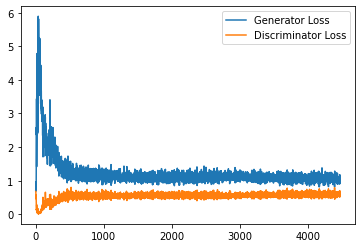

Step 90000: Generator loss: 1.0506527189016341, discriminator loss: 0.5893443602323533


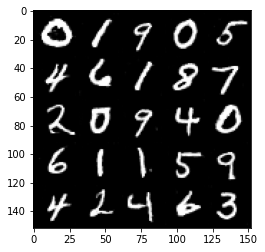

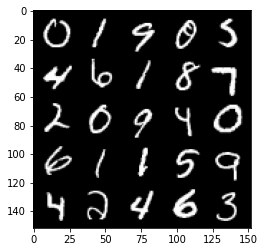

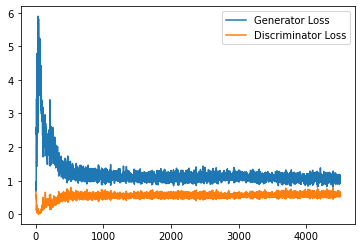

Step 90500: Generator loss: 1.0635431249141694, discriminator loss: 0.5923541184067727


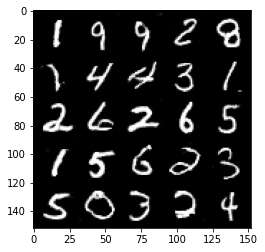

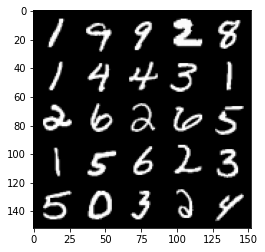

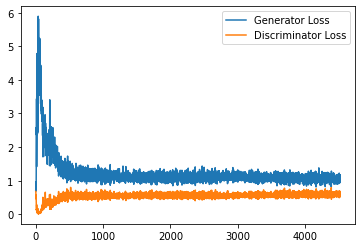

Step 91000: Generator loss: 1.073185316681862, discriminator loss: 0.597901541352272


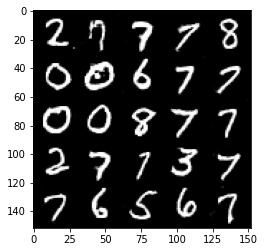

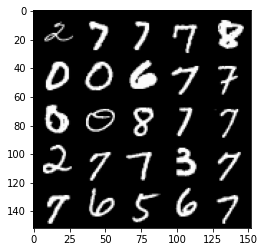

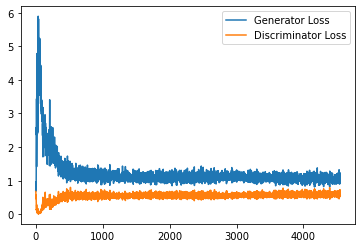

Step 91500: Generator loss: 1.0348619616031647, discriminator loss: 0.5929823808073997


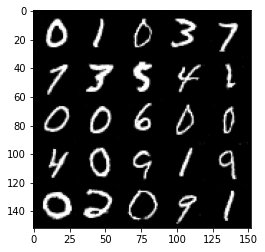

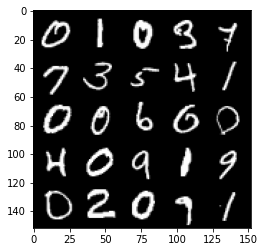

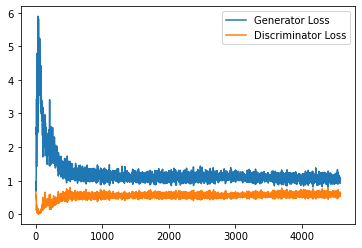

Step 92000: Generator loss: 1.0377901302576065, discriminator loss: 0.5944348459243775


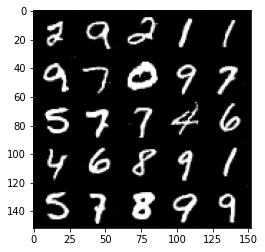

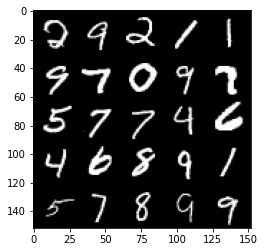

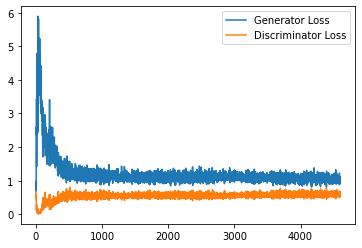

Step 92500: Generator loss: 1.0534764877557754, discriminator loss: 0.591189628124237


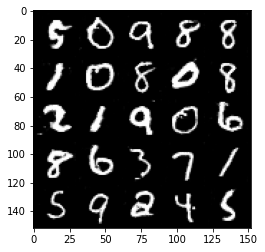

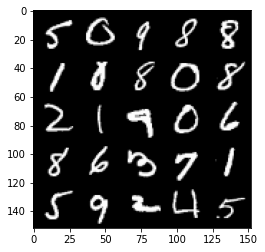

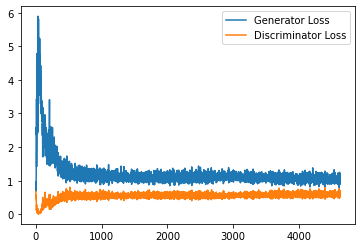

Step 93000: Generator loss: 1.052067396759987, discriminator loss: 0.6012072855234146


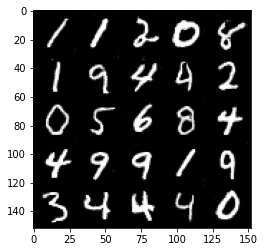

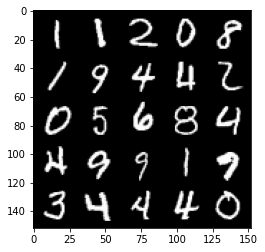

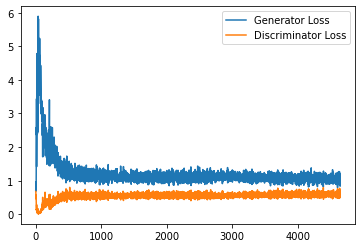

Step 93500: Generator loss: 1.0580371961593629, discriminator loss: 0.5907858473062515


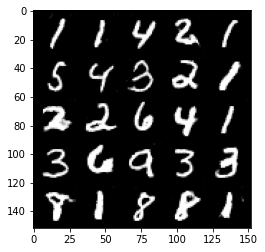

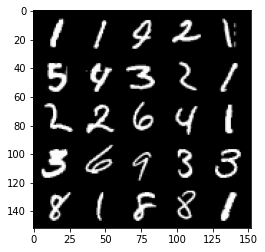

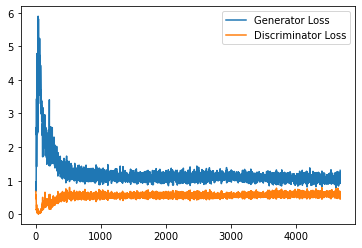

In [44]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

In [ ]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()